In [1]:
%pylab inline
import os
from os import path
import cv2 as cv

import numpy as np
import pydicom as dicom
import png
import pandas as pd
import matplotlib.pyplot as plt
from pydicom.data import get_testdata_files
from pydicom import read_file
import matplotlib.image as mpimg 
from PIL import Image
import skimage.io as io
from skimage import morphology
from skimage import measure
from skimage.transform import resize
from sklearn.cluster import KMeans
from mask_functions import rle2mask
import glob
import sys

Populating the interactive namespace from numpy and matplotlib


# Load some data for exploration

In [2]:
img_info=pd.read_csv('mass_case_description_train_set2.csv',sep=",")
img_info.head()

,patient_id,breast_density,left or right breast,image view,abnormality id,abnormality type,mass shape,mass margins,assessment,pathology,subtlety,image_file_path,cropped_image_file_path,ROI_mask_file_path
0,P_00001,3,LEFT,CC,1,mass,IRREGULAR-ARCHITECTURAL_DISTORTION,SPICULATED,4,MALIGNANT,4,Mass-Training_P_00001_LEFT_CC_000000.dcm,Mass-Training_P_00001_LEFT_CC_1_000000.dcm,Mass-Training_P_00001_LEFT_CC_1_000001.dcm
1,P_00001,3,LEFT,MLO,1,mass,IRREGULAR-ARCHITECTURAL_DISTORTION,SPICULATED,4,MALIGNANT,4,Mass-Training_P_00001_LEFT_MLO_000000.dcm,Mass-Training_P_00001_LEFT_MLO_1_000000.dcm,Mass-Training_P_00001_LEFT_MLO_1_000001.dcm
2,P_00004,3,LEFT,CC,1,mass,ARCHITECTURAL_DISTORTION,ILL_DEFINED,4,BENIGN,3,Mass-Training_P_00004_LEFT_CC_000000.dcm,Mass-Training_P_00004_LEFT_CC_1_000000.dcm,Mass-Training_P_00004_LEFT_CC_1_000001.dcm
3,P_00004,3,LEFT,MLO,1,mass,ARCHITECTURAL_DISTORTION,ILL_DEFINED,4,BENIGN,3,Mass-Training_P_00004_LEFT_MLO_000000.dcm,Mass-Training_P_00004_LEFT_MLO_1_000000.dcm,Mass-Training_P_00004_LEFT_MLO_1_000001.dcm
4,P_00004,3,RIGHT,MLO,1,mass,OVAL,CIRCUMSCRIBED,4,BENIGN,5,Mass-Training_P_00004_RIGHT_MLO_000000.dcm,Mass-Training_P_00004_RIGHT_MLO_1_000000.dcm,Mass-Training_P_00004_RIGHT_MLO_1_000001.dcm


# image

In [3]:
patient_id=img_info['patient_id'][9]
image_name=img_info['image_file_path'][9]
image_path="image_cancer/"+img_info['image_file_path'][9]
cropped_path="image_cancer/"+img_info['cropped_image_file_path'][9]
ROI_path="image_cancer/"+img_info['ROI_mask_file_path'][9]

In [4]:
image_name

'Mass-Training_P_00018_RIGHT_MLO_000000.dcm'

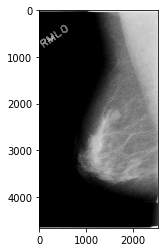

In [5]:
lung = dicom.read_file(image_path)

slice = lung.pixel_array
slice[slice == -2000] = 0
plt.imshow(slice, cmap=plt.cm.gray)

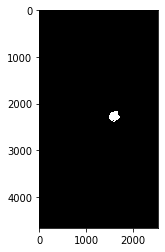

In [6]:
lung = dicom.read_file(cropped_path)

slice = lung.pixel_array
slice[slice == -2000] = 0
plt.imshow(slice, cmap=plt.cm.gray)

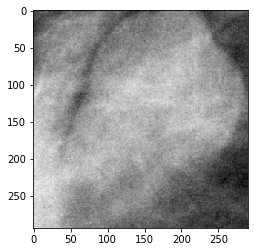

In [7]:
lung = dicom.read_file(ROI_path)

slice = lung.pixel_array
slice[slice == -2000] = 0
plt.imshow(slice, cmap=plt.cm.gray)

In [8]:
def show_dcm_info(dataset):
    #print(dataset)
    print("Filename.........:", image_path)
    print("Storage type.....:", dataset.SOPClassUID)
    print()

    pat_name = dataset.PatientName
    display_name = pat_name.family_name + ", " + pat_name.given_name
    print("Series Description .....:", dataset.SeriesDescription)
    print("Patient's name..........:", display_name)
    print("Patient id..............:", dataset.PatientID)  
    print("Body Part Examined......:",dataset.BodyPartExamined)
    print("Patient Orientation.....:",dataset.PatientOrientation)
     
    if 'PixelData' in dataset:
        rows = int(dataset.Rows)
        cols = int(dataset.Columns)
        print("Image size.......: {rows:d} x {cols:d}, {size:d} bytes".format(
            rows=rows, cols=cols, size=len(dataset.PixelData)))
        if 'PixelSpacing' in dataset:
            print("Pixel spacing....:", dataset.PixelSpacing)

In [9]:
def plot_pixel_array(dataset, figsize=(10,10)):
    plt.figure(figsize=figsize)
    plt.imshow(dataset.pixel_array, cmap=plt.cm.bone)
    #plt.savefig(patient_id+".png",orientation='landscape',format='png',quality=95,transparent=True,figsize=(4808,3024), dpi=80)
    plt.show()

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00051_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00051_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4704 x 2472, 11628288 bytes


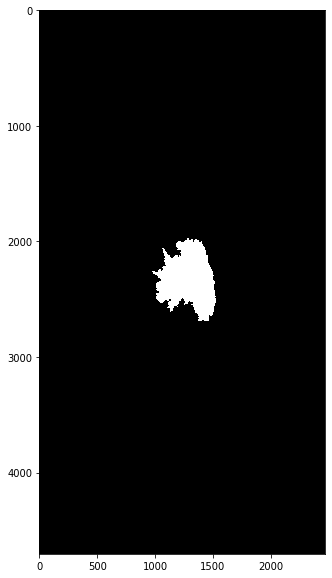

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00021_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00021_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4576 x 2784, 12739584 bytes


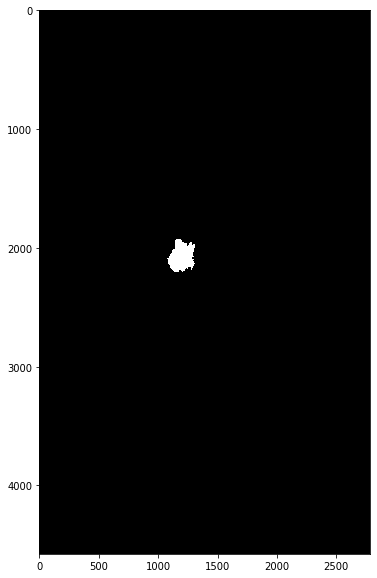

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00059_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00059_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 267 x 346, 184764 bytes


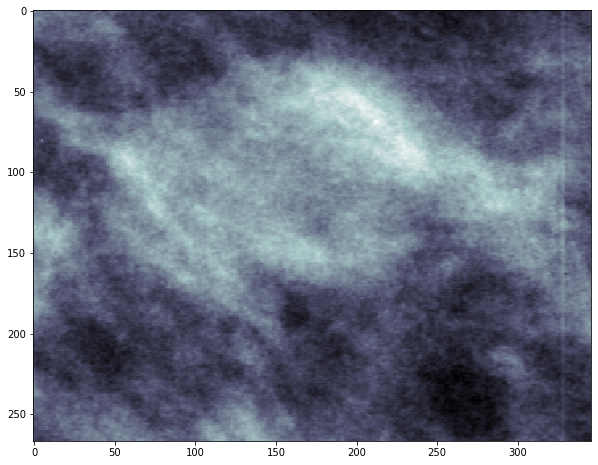

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00045_LEFT_CC, 
Patient id..............: Mass-Training_P_00045_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 3166, 34769012 bytes


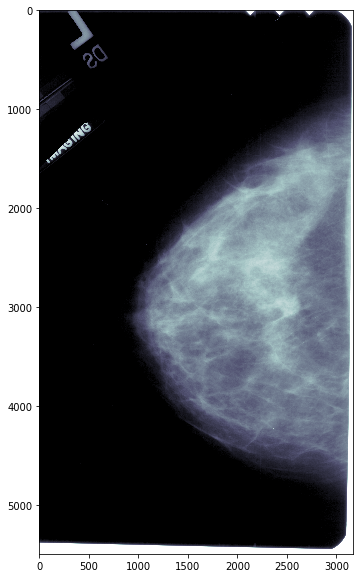

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00021_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00021_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 185 x 194, 71780 bytes


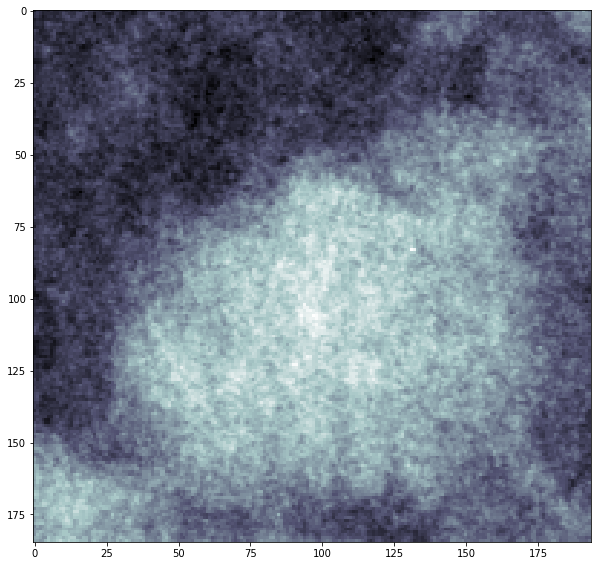

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00054_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00054_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 286 x 269, 153868 bytes


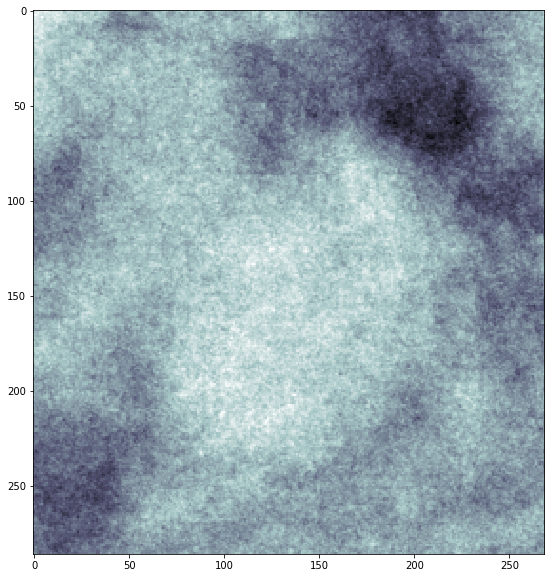

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00051_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00051_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 763 x 594, 906444 bytes


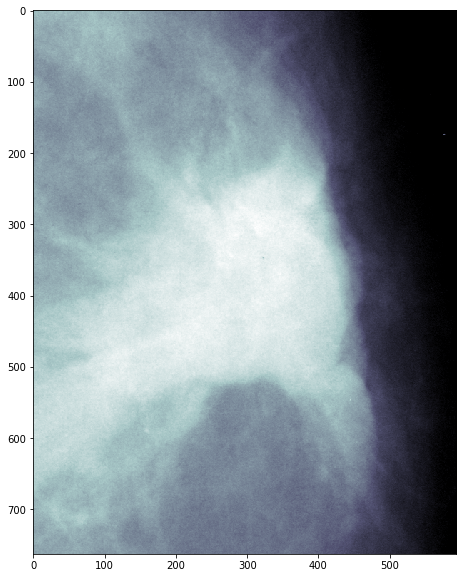

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00051_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00051_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 812 x 550, 893200 bytes


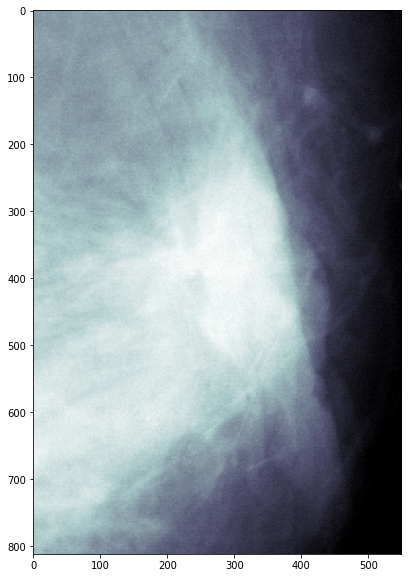

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00039_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00039_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 475 x 476, 452200 bytes


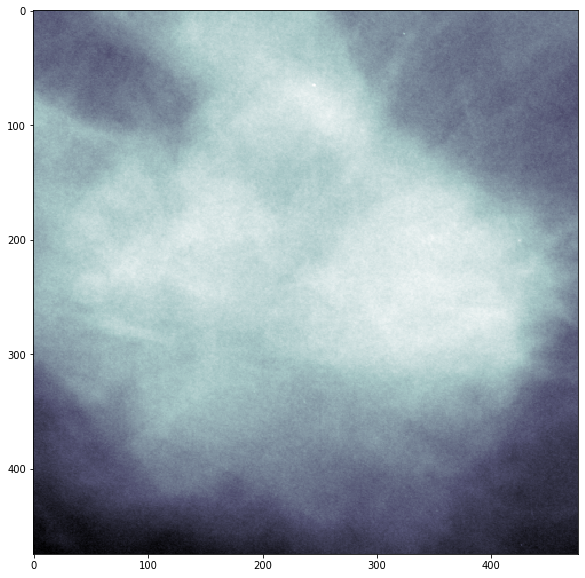

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00055_LEFT_CC, 
Patient id..............: Mass-Training_P_00055_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5386 x 3046, 32811512 bytes


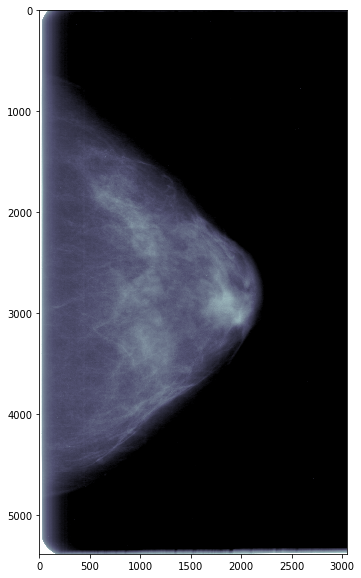

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00018_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00018_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4720 x 2584, 12196480 bytes


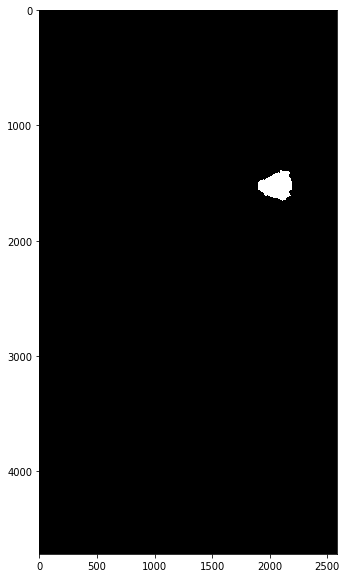

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00001_LEFT_MLO, 
Patient id..............: Mass-Training_P_00001_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4800 x 2656, 25497600 bytes


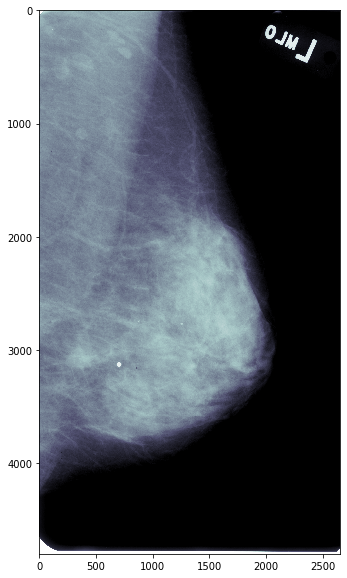

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00034_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00034_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6871 x 3541, 48660422 bytes


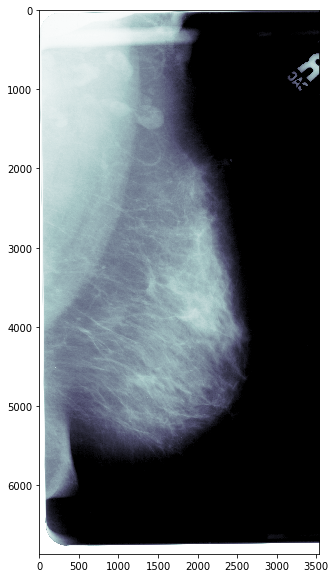

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00023_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00023_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6001 x 3286, 39438572 bytes


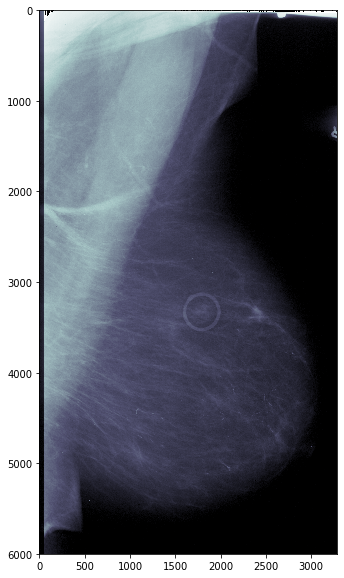

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00026_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00026_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 271 x 249, 134958 bytes


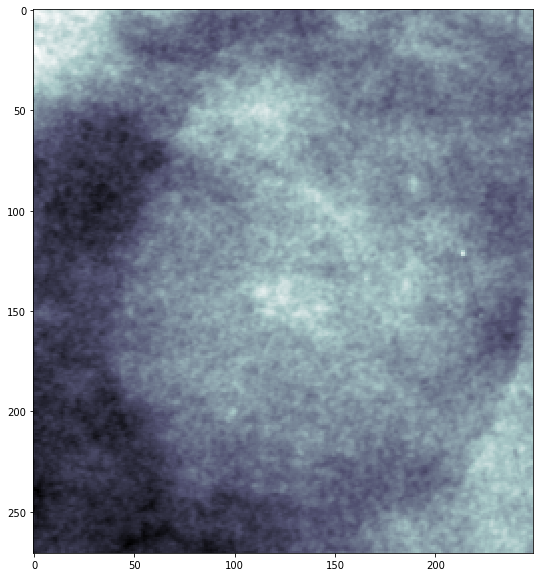

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00046_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00046_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4488 x 2944, 13212672 bytes


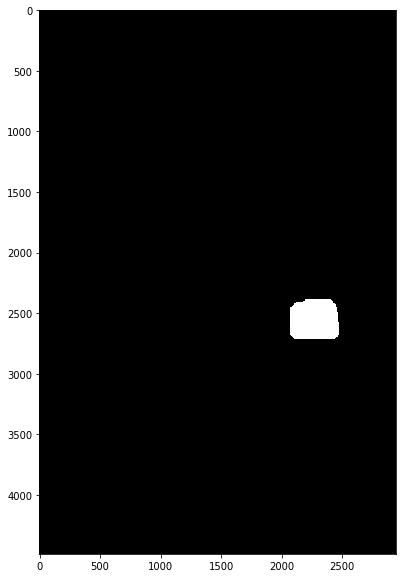

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00026_LEFT_MLO, 
Patient id..............: Mass-Training_P_00026_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6796 x 3361, 45682712 bytes


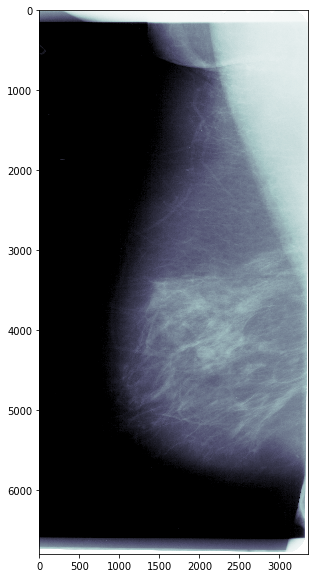

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00018_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00018_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4664 x 2544, 11865216 bytes


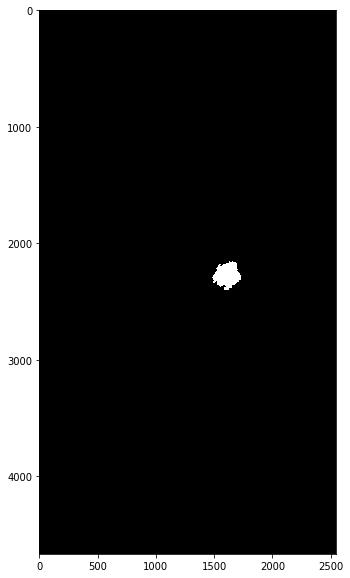

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00039_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00039_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4720 x 2760, 26054400 bytes


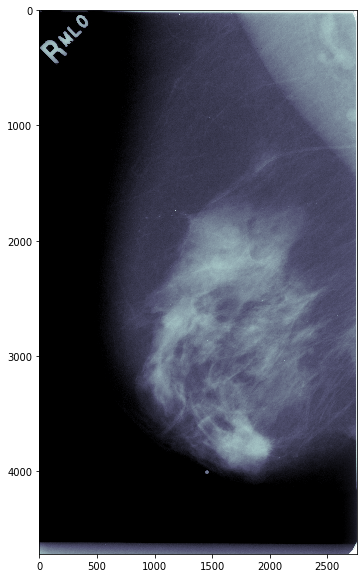

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00009_RIGHT_CC, 
Patient id..............: Mass-Training_P_00009_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4441 x 2206, 19593692 bytes


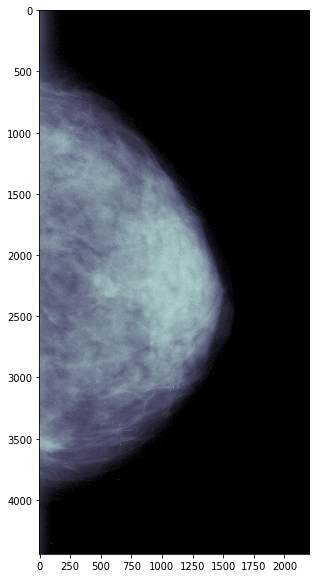

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00059_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00059_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4686 x 3133, 14681238 bytes


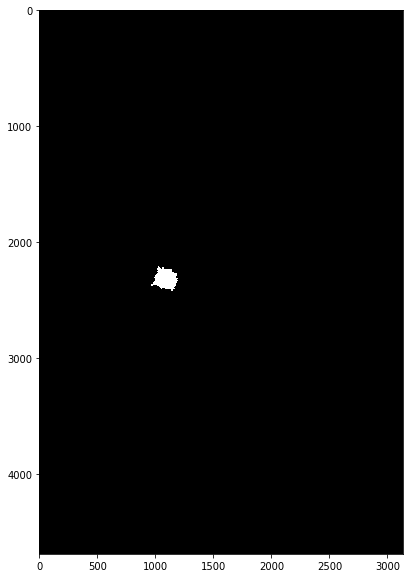

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00015_LEFT_MLO, 
Patient id..............: Mass-Training_P_00015_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5552 x 4000, 44416000 bytes


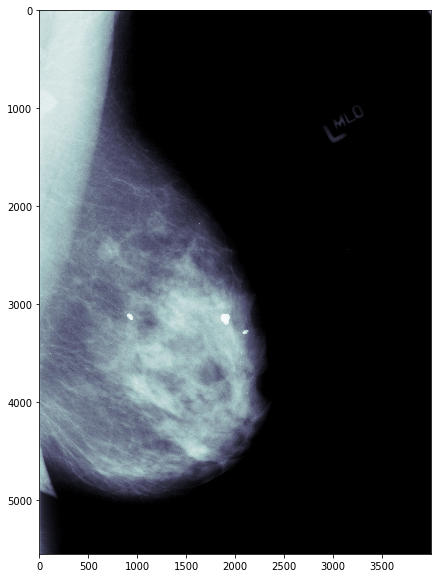

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_2, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_2
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 314 x 397, 249316 bytes


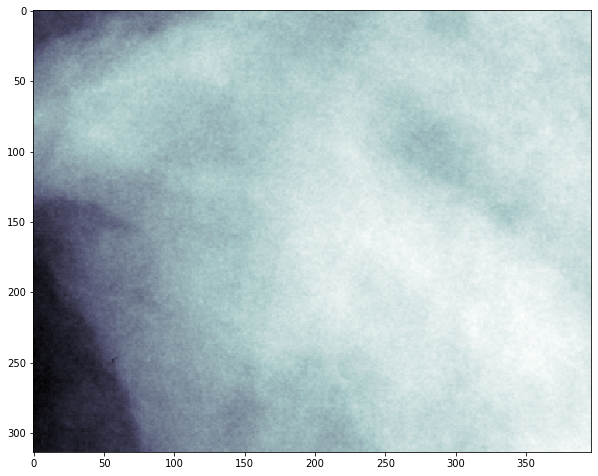

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00059_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00059_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4686 x 3016, 14132976 bytes


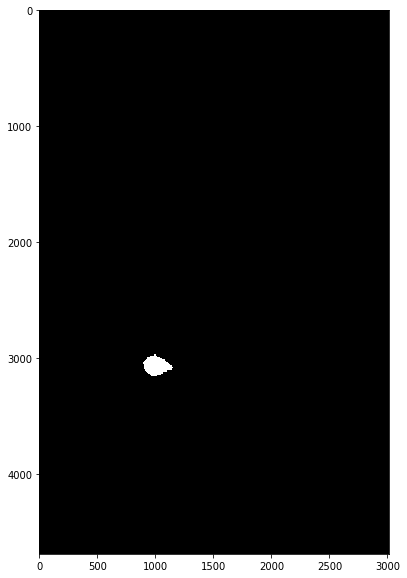

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00044_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00044_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4552 x 2960, 26947840 bytes


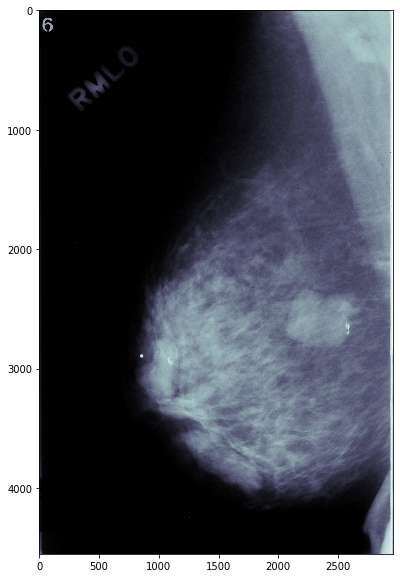

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00034_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00034_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 6451 x 3406, 21972106 bytes


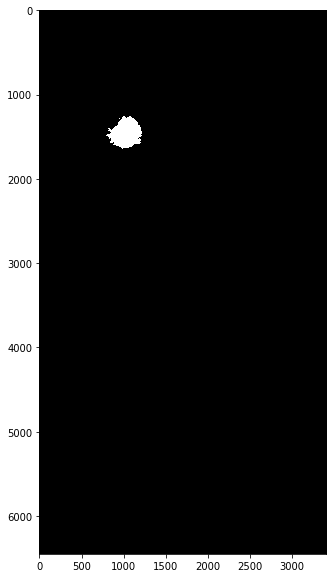

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00058_RIGHT_CC, 
Patient id..............: Mass-Training_P_00058_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5311 x 4411, 46853642 bytes


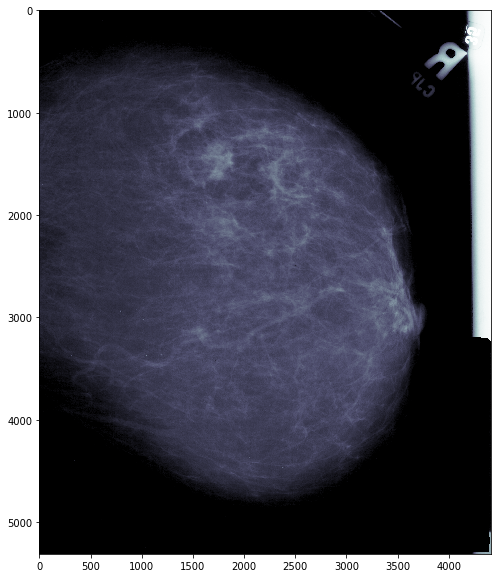

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00027_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00027_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 369 x 326, 240588 bytes


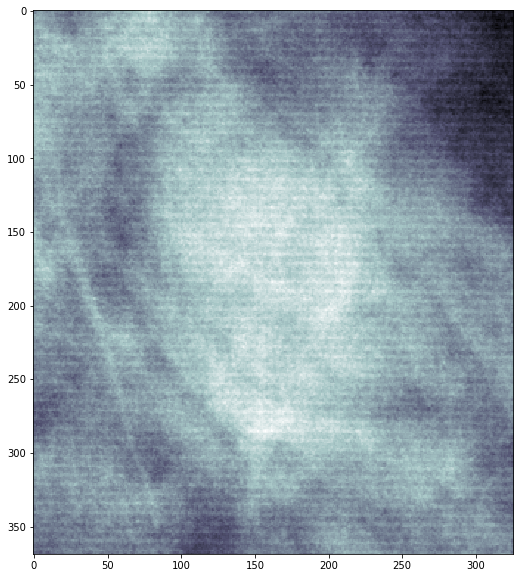

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00039_RIGHT_CC, 
Patient id..............: Mass-Training_P_00039_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4688 x 2704, 25352704 bytes


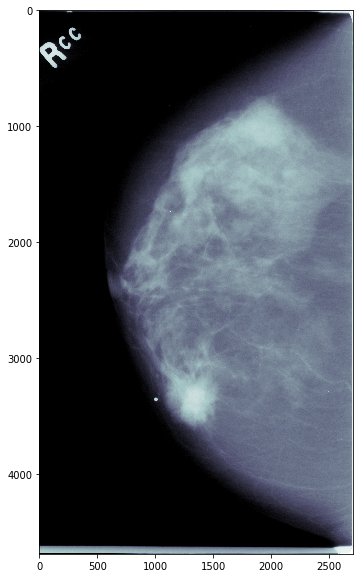

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00023_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00023_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6001 x 3286, 19719286 bytes


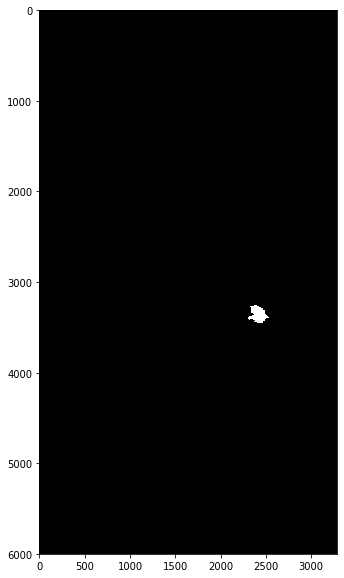

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00045_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00045_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 336 x 370, 248640 bytes


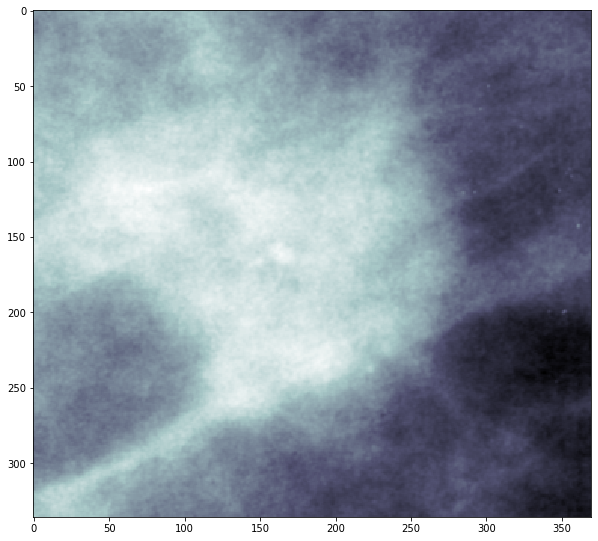

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_3, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_3
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4504 x 2888, 13007552 bytes


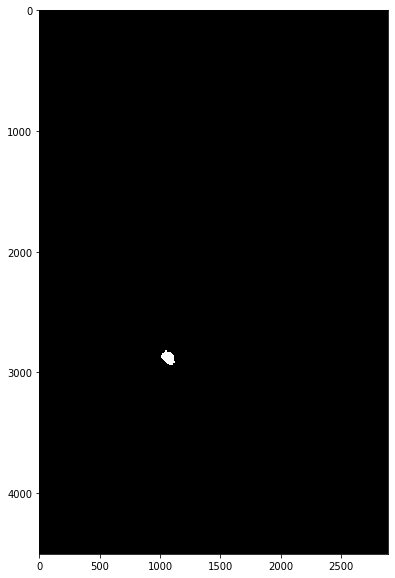

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00023_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00023_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 246 x 267, 131364 bytes


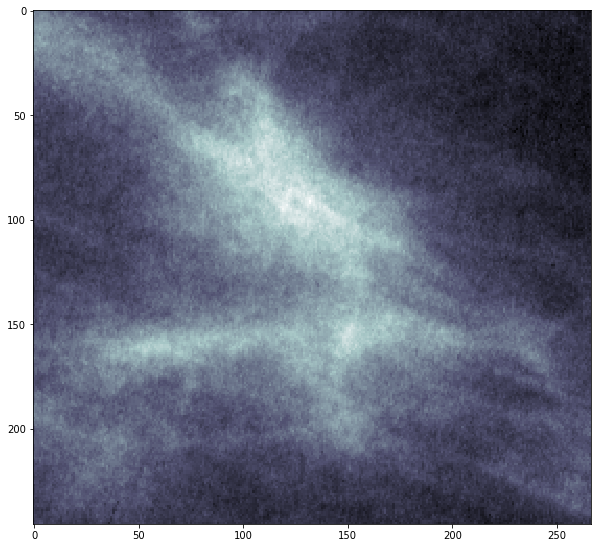

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00009_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00009_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 271 x 220, 119240 bytes


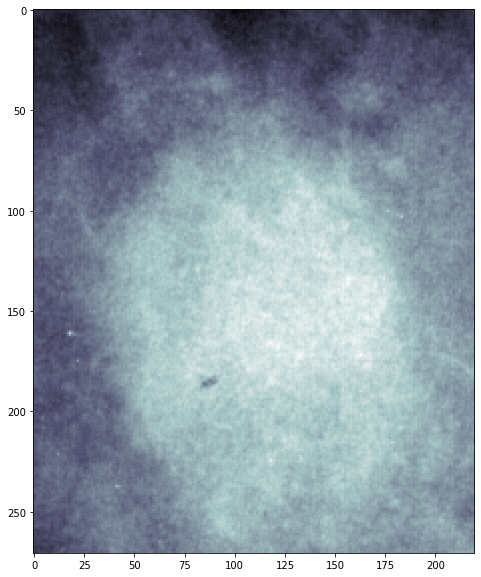

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00057_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00057_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 268 x 330, 176880 bytes


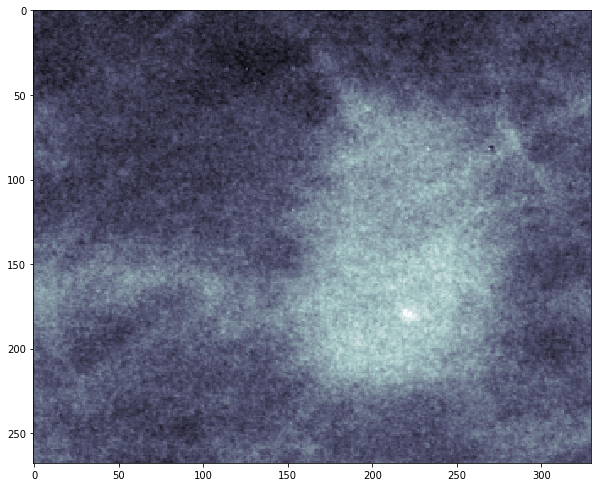

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00004_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00004_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 399 x 465, 371070 bytes


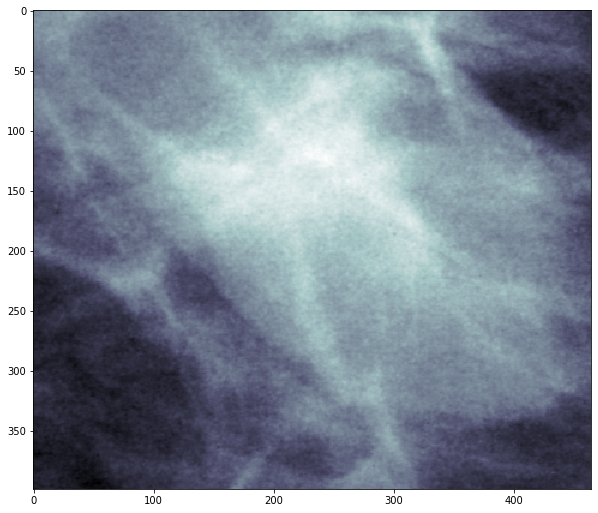

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 263 x 247, 129922 bytes


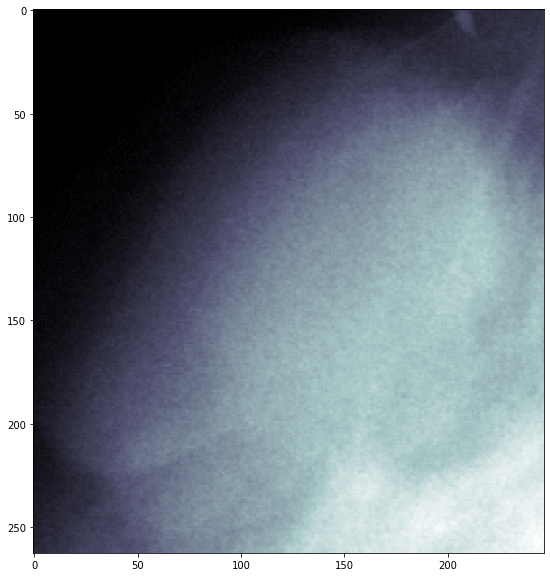

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00027_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00027_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 411 x 449, 369078 bytes


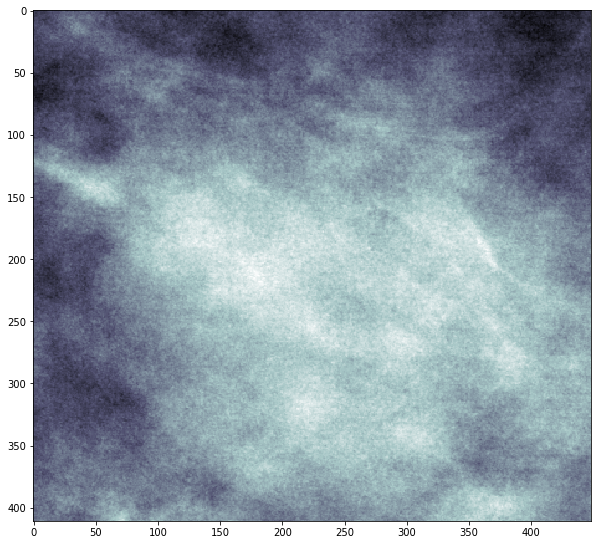

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00004_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00004_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 3046, 16725586 bytes


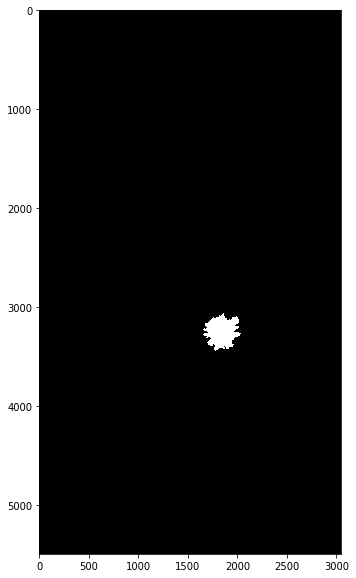

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_3, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_3
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 168 x 160, 53760 bytes


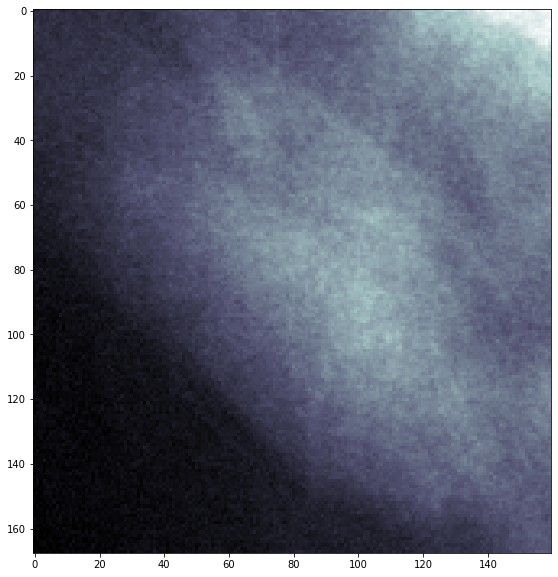

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00021_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00021_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4480 x 2904, 13009920 bytes


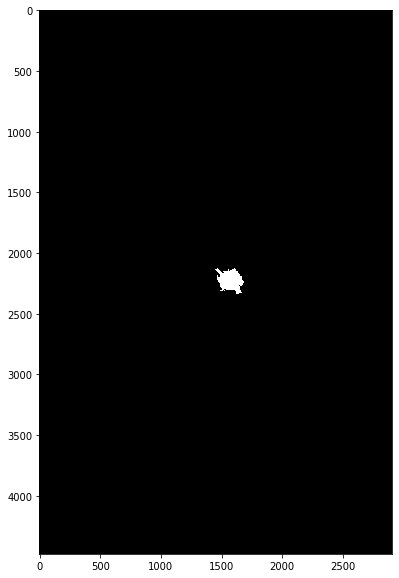

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00044_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 520 x 574, 596960 bytes


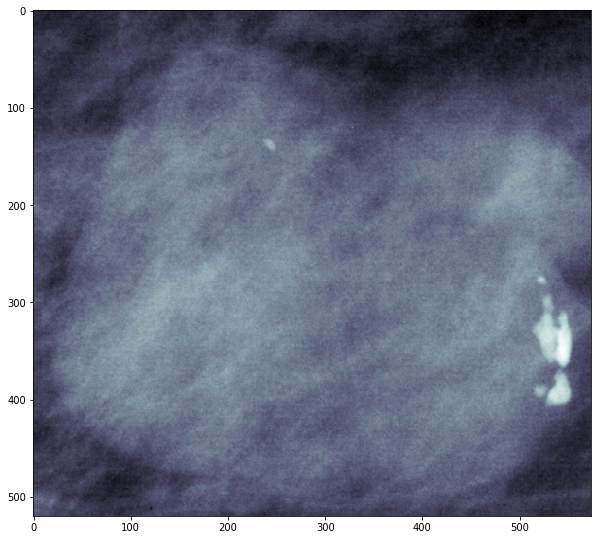

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00021_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00021_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4576 x 2784, 25479168 bytes


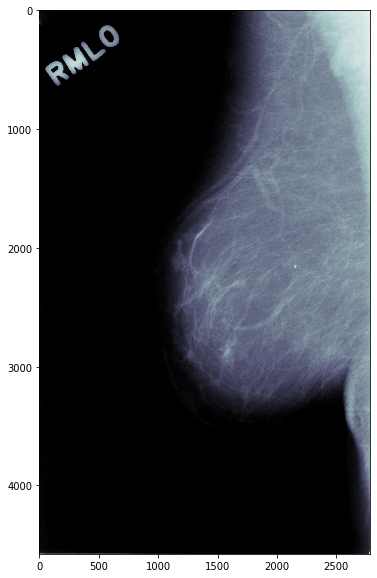

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00027_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00027_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5904 x 3760, 22199040 bytes


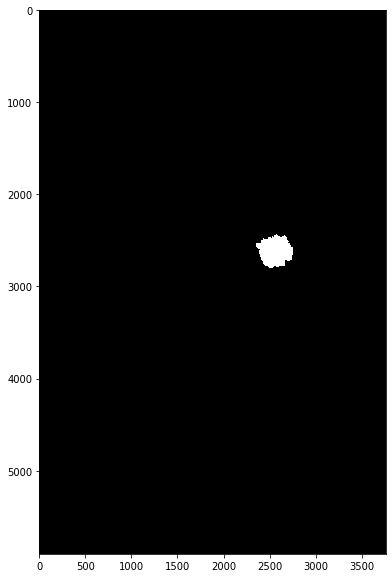

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00004_LEFT_CC, 
Patient id..............: Mass-Training_P_00004_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 2986, 32792252 bytes


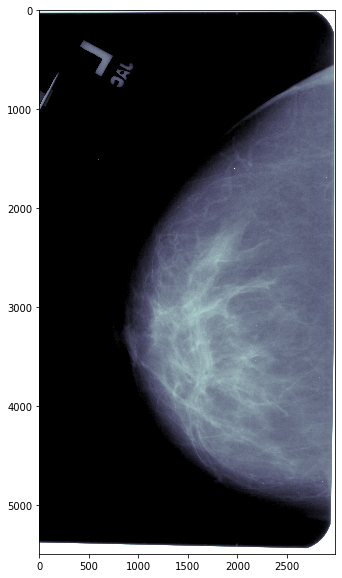

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00021_LEFT_MLO, 
Patient id..............: Mass-Training_P_00021_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4480 x 2904, 26019840 bytes


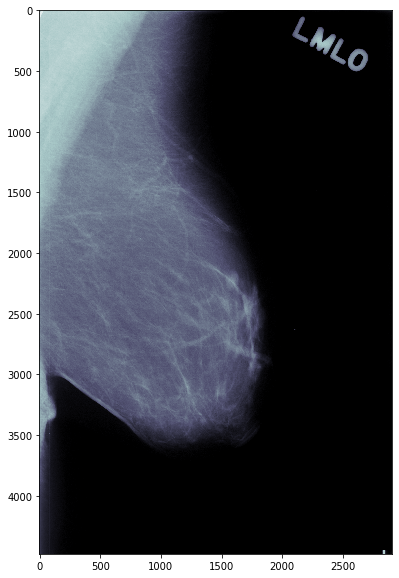

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00057_RIGHT_CC, 
Patient id..............: Mass-Training_P_00057_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4744 x 2584, 24516992 bytes


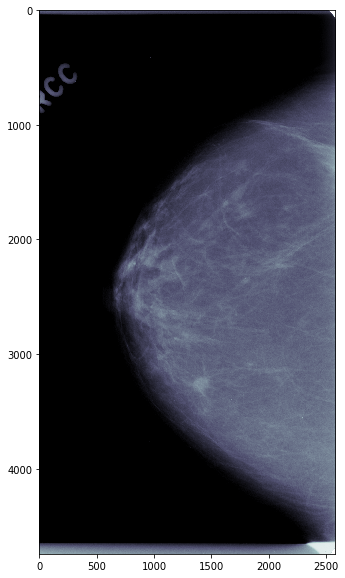

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00034_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00034_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 435 x 474, 412380 bytes


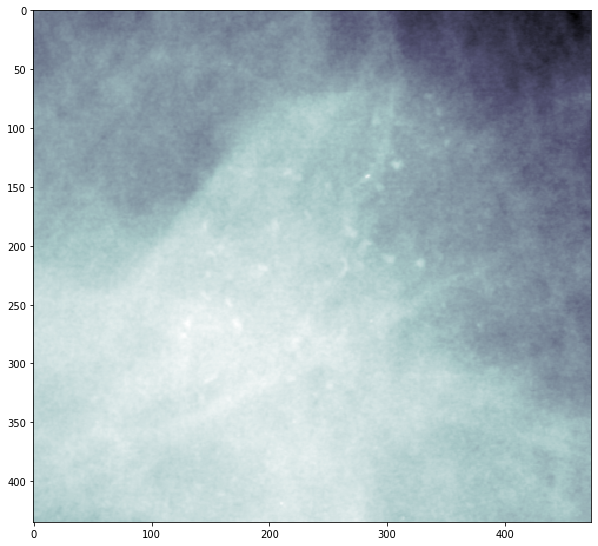

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00041_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00041_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 203 x 212, 86072 bytes


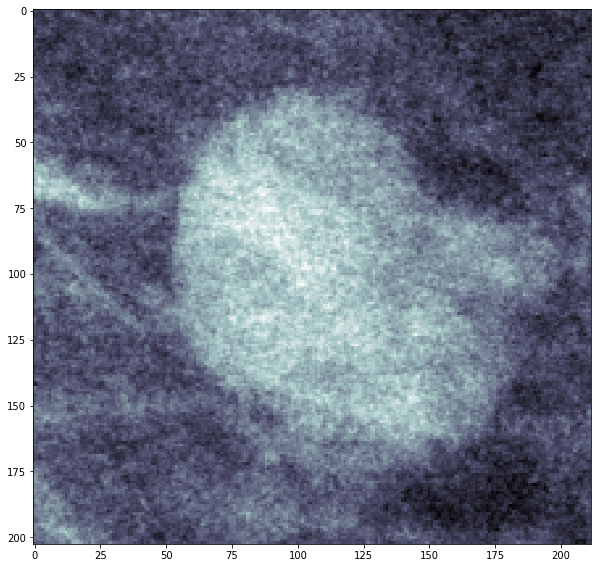

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00004_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00004_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 2911, 31968602 bytes


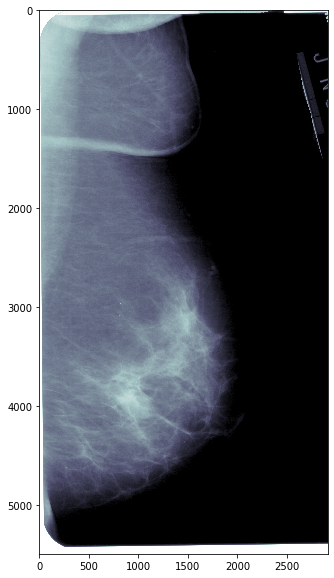

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00045_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00045_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 3166, 17384506 bytes


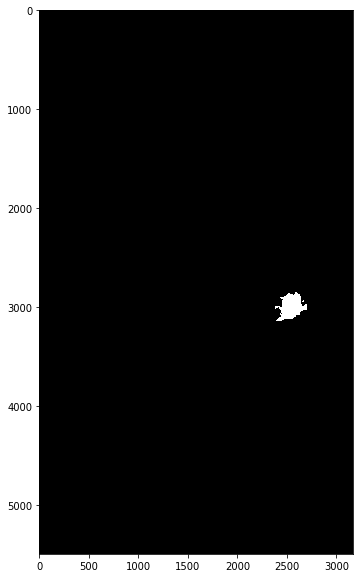

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00044_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4552 x 2960, 13473920 bytes


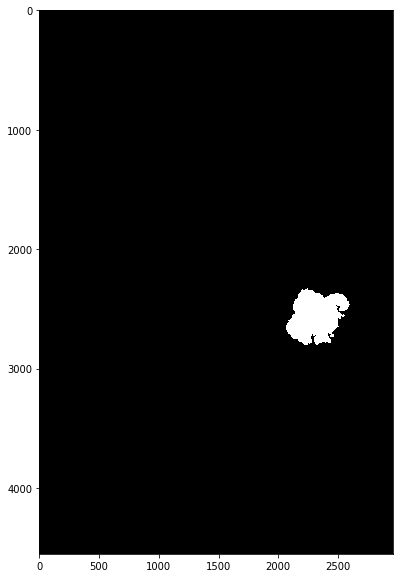

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00054_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00054_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4520 x 2920, 13198400 bytes


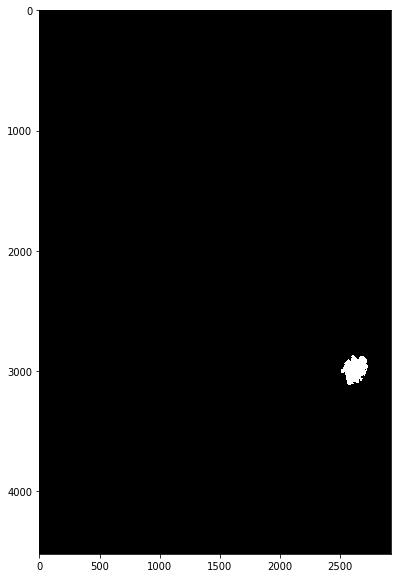

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00018_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00018_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 306 x 344, 210528 bytes


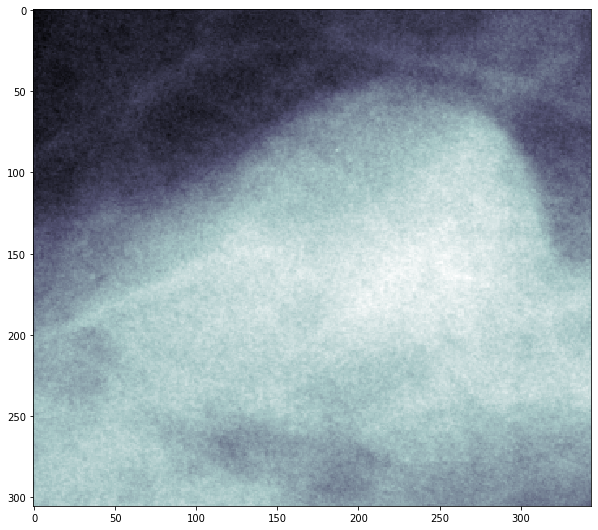

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00058_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00058_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 462 x 408, 376992 bytes


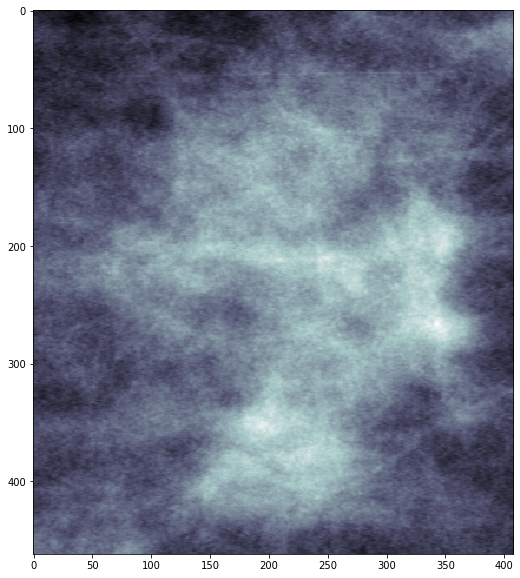

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00051_LEFT_MLO, 
Patient id..............: Mass-Training_P_00051_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4704 x 2552, 24009216 bytes


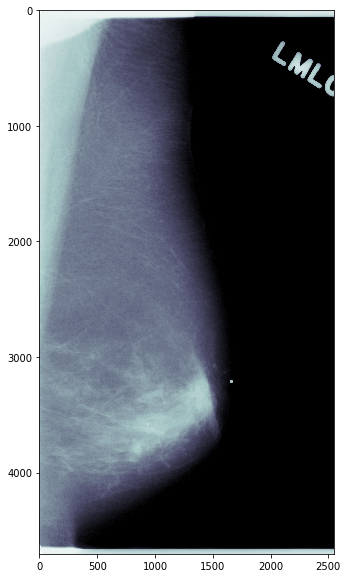

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00015_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00015_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 275 x 284, 156200 bytes


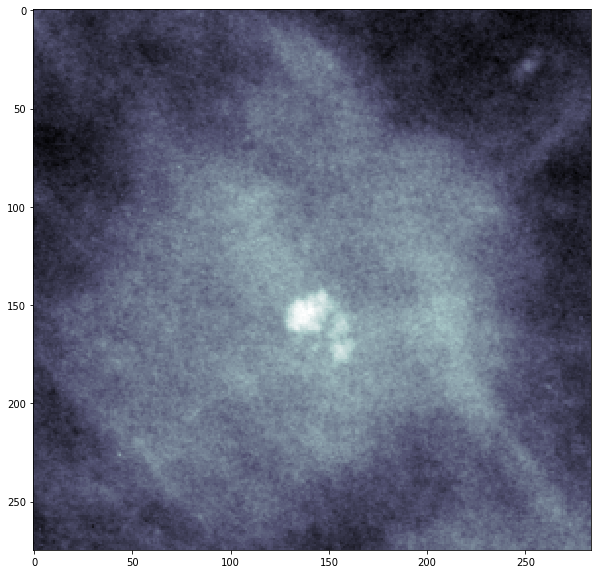

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00023_RIGHT_CC, 
Patient id..............: Mass-Training_P_00023_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 3301, 36251582 bytes


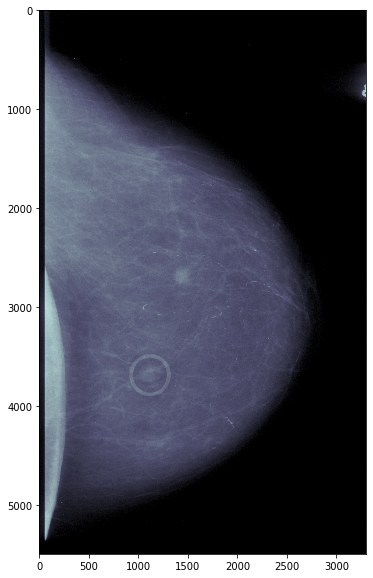

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00059_LEFT_MLO, 
Patient id..............: Mass-Training_P_00059_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5386 x 3466, 37335752 bytes


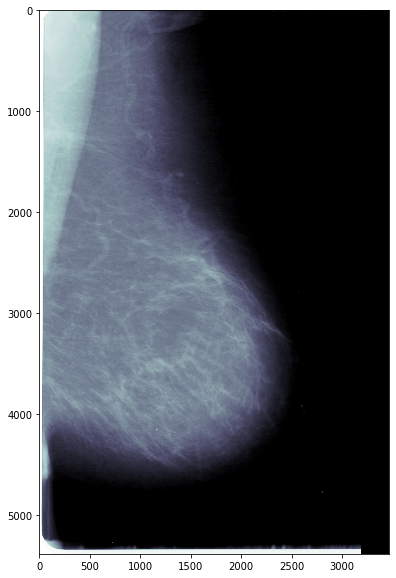

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00026_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00026_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 242 x 275, 133100 bytes


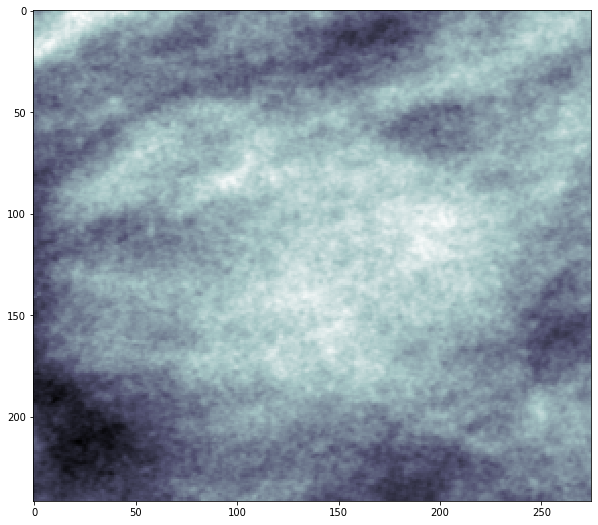

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00021_LEFT_CC, 
Patient id..............: Mass-Training_P_00021_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4424 x 2928, 25906944 bytes


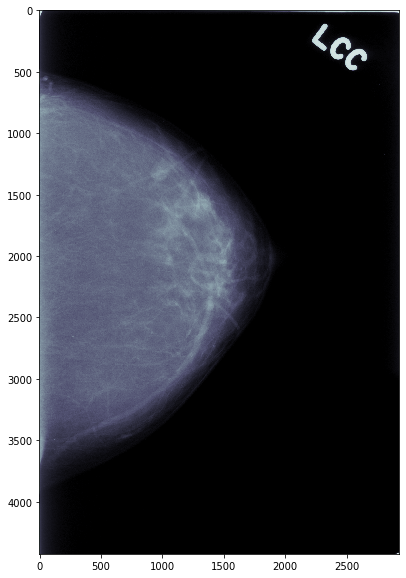

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00059_LEFT_CC, 
Patient id..............: Mass-Training_P_00059_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5386 x 3601, 38789972 bytes


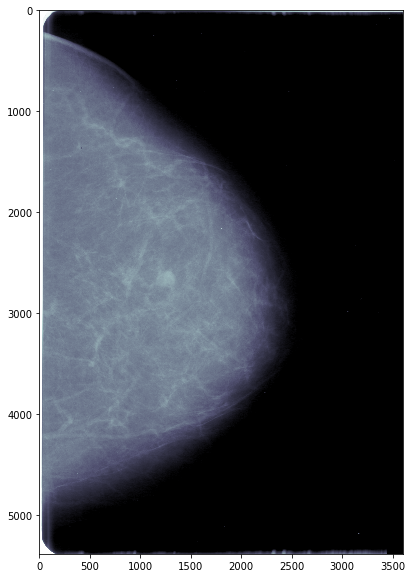

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00027_RIGHT_CC, 
Patient id..............: Mass-Training_P_00027_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5896 x 3800, 44809600 bytes


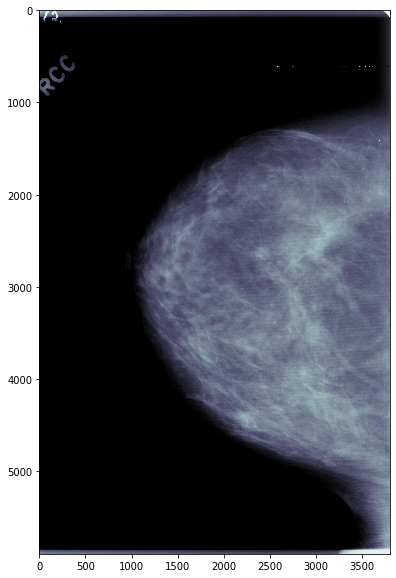

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00057_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00057_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4704 x 2680, 12606720 bytes


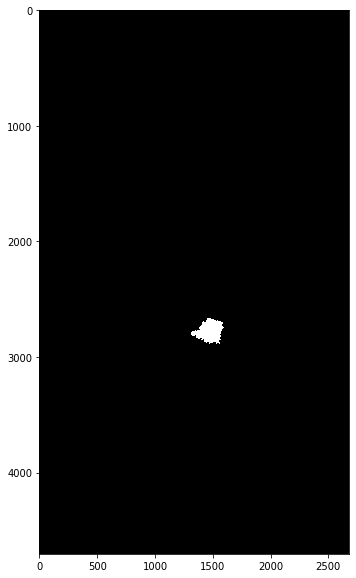

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00034_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00034_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 438 x 392, 343392 bytes


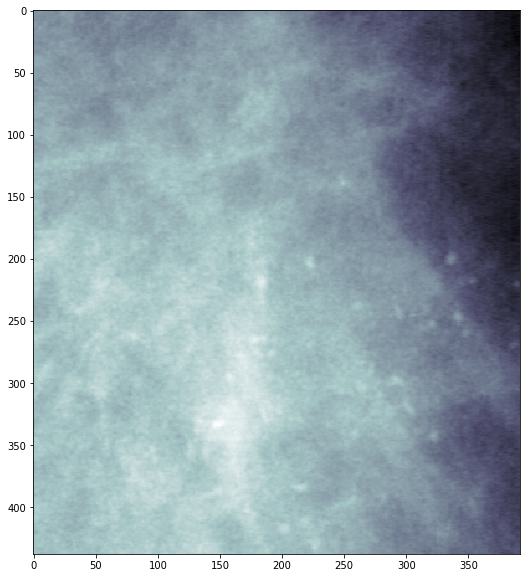

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00041_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00041_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5664 x 4040, 22882560 bytes


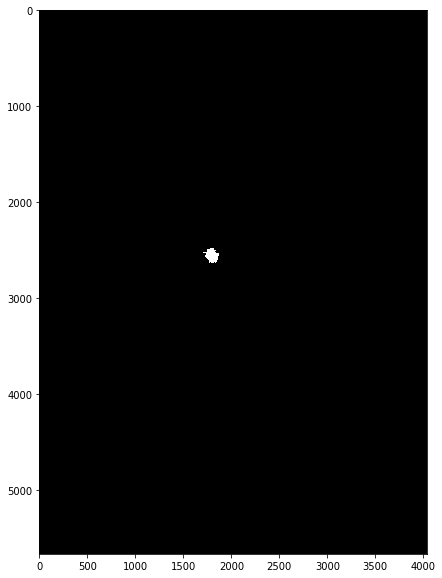

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00001_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00001_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4808 x 3024, 14539392 bytes


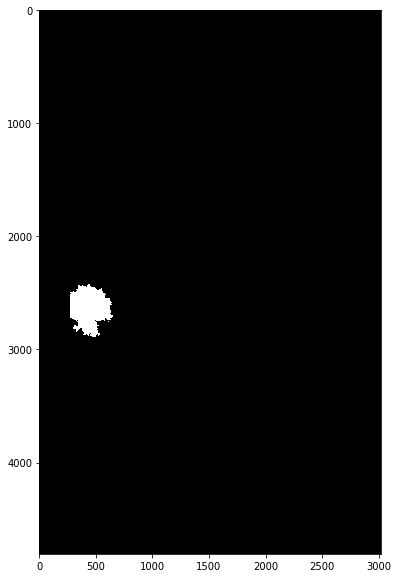

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00009_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00009_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5266 x 2596, 13670536 bytes


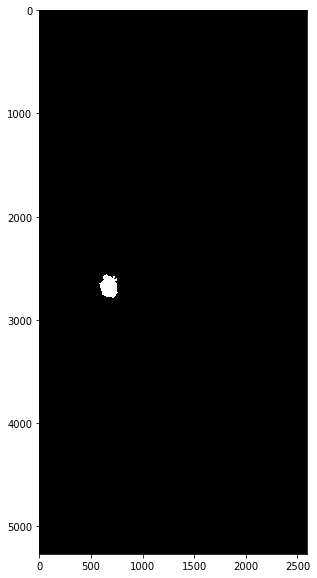

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00039_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00039_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4688 x 2704, 12676352 bytes


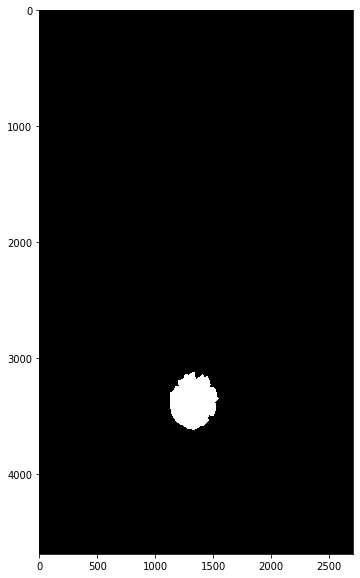

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00051_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00051_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4704 x 2552, 12004608 bytes


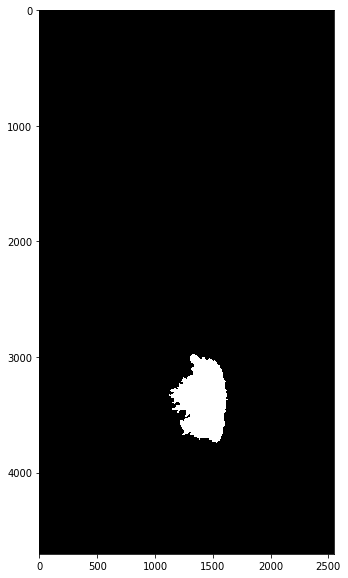

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00004_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00004_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 2986, 16396126 bytes


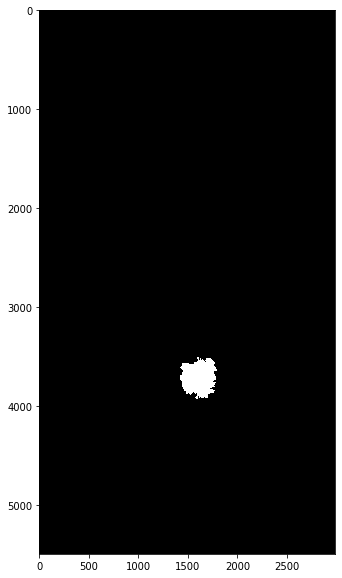

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00055_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00055_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 473 x 438, 414348 bytes


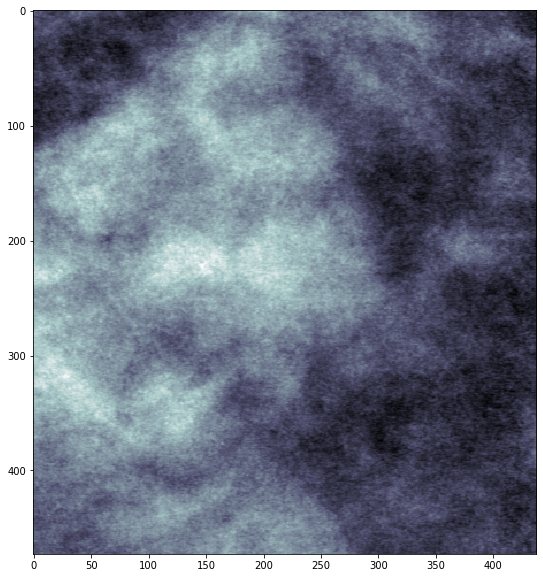

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00054_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00054_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4520 x 2920, 26396800 bytes


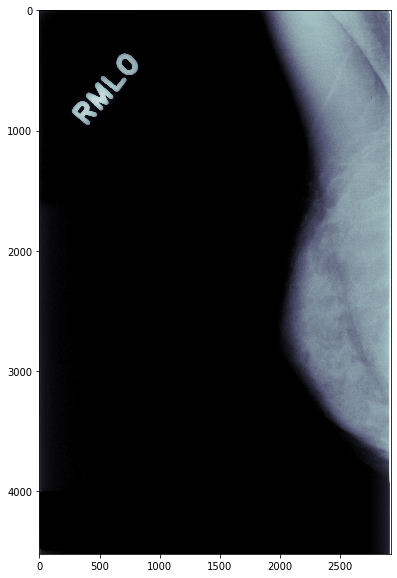

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00015_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00015_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5552 x 4000, 22208000 bytes


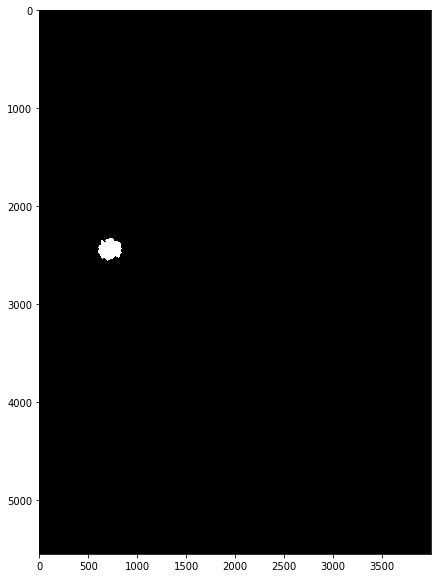

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00041_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00041_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5664 x 3984, 22565376 bytes


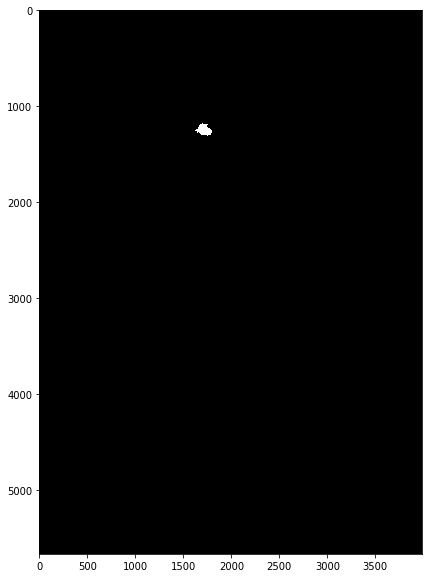

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00021_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00021_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 329 x 276, 181608 bytes


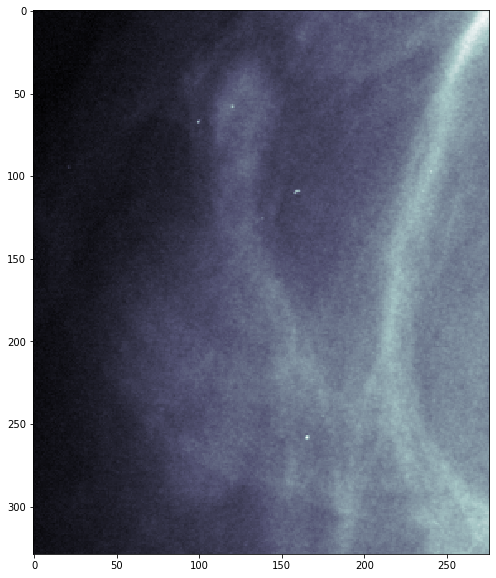

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00021_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00021_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4568 x 2872, 13119296 bytes


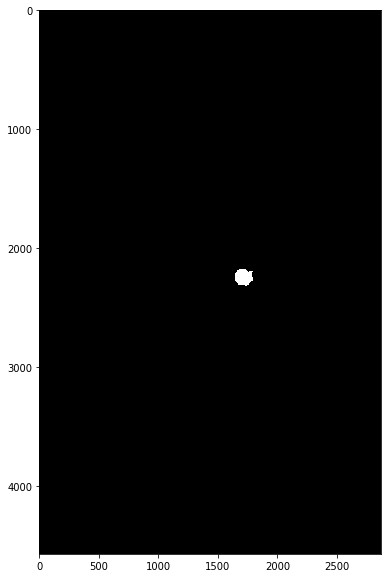

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_4, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_4
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 458 x 475, 435100 bytes


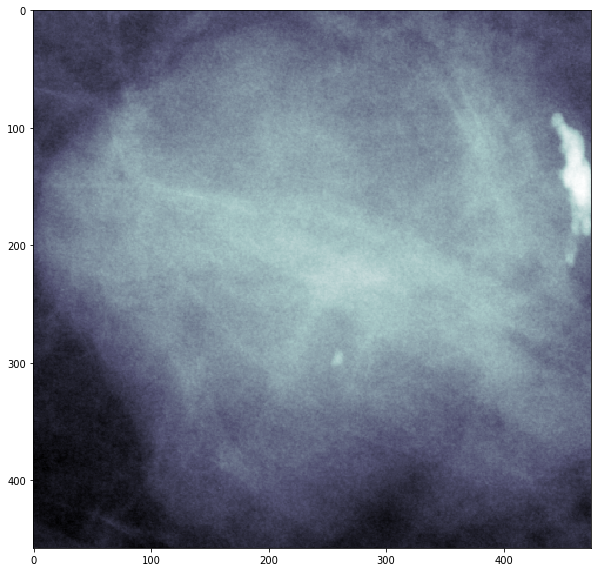

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00059_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00059_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 275 x 318, 174900 bytes


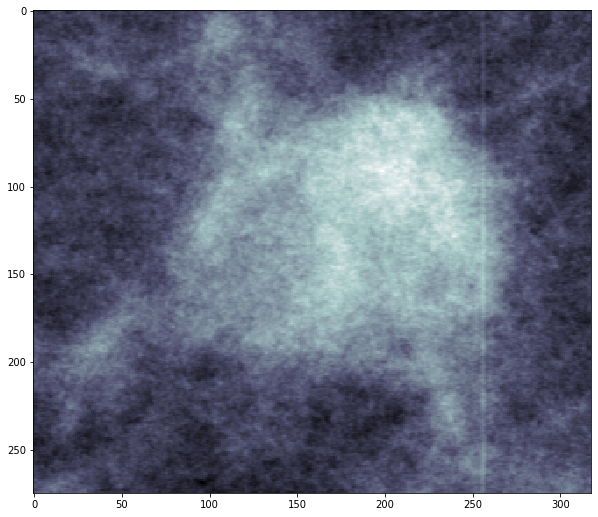

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00018_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00018_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 294 x 290, 170520 bytes


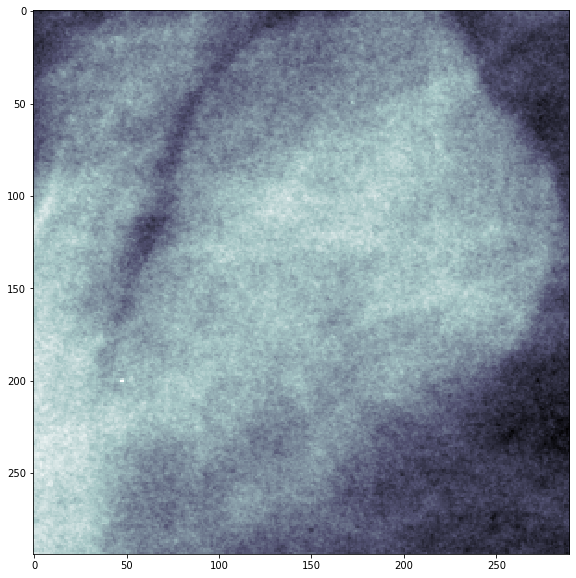

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00057_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00057_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4704 x 2680, 25213440 bytes


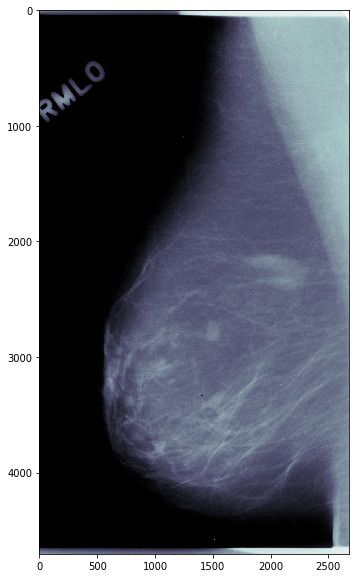

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00026_LEFT_CC, 
Patient id..............: Mass-Training_P_00026_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 6706 x 3421, 45882452 bytes


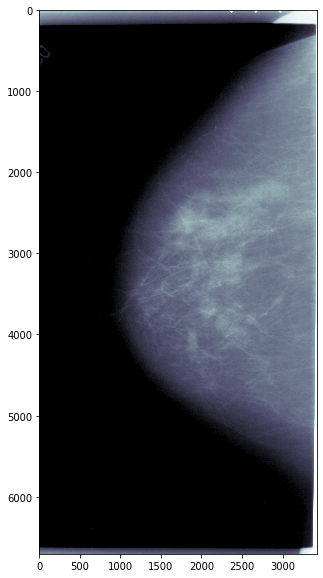

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00044_RIGHT_MLO_2, 
Patient id..............: Mass-Training_P_00044_RIGHT_MLO_2
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 653 x 446, 582476 bytes


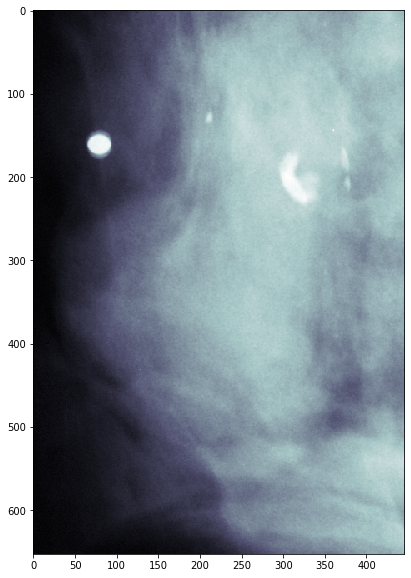

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00001_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00001_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 515 x 431, 443930 bytes


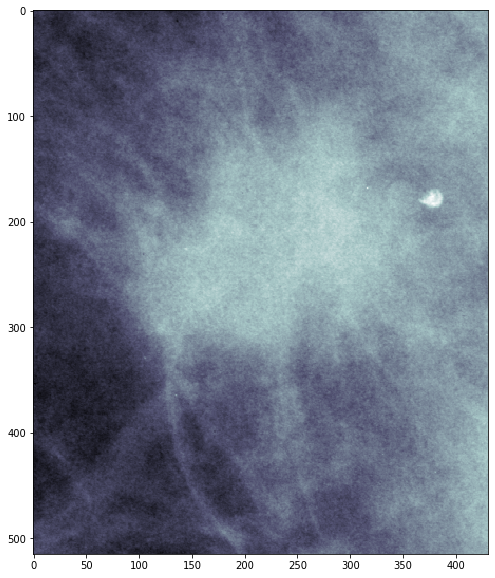

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00058_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00058_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5311 x 4411, 23426822 bytes


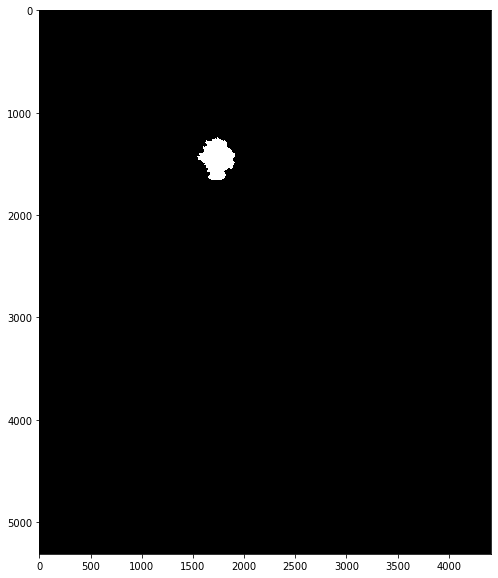

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00045_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00045_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 280 x 282, 157920 bytes


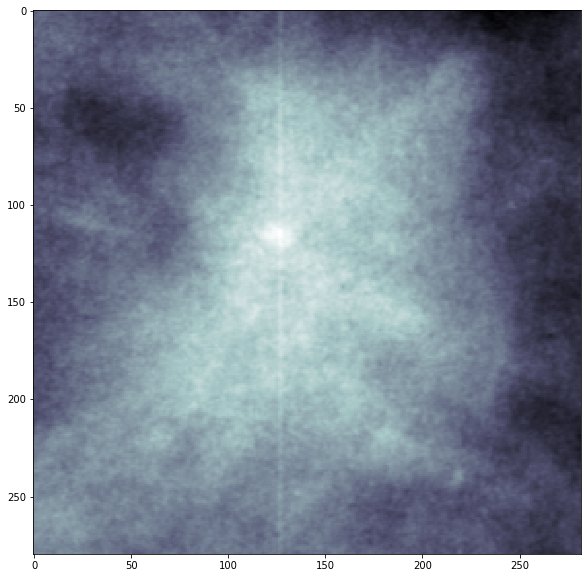

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00009_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00009_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 221 x 240, 106080 bytes


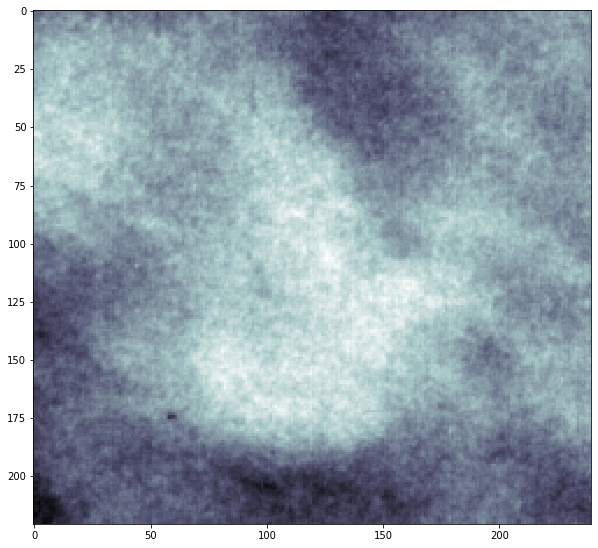

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00021_RIGHT_CC, 
Patient id..............: Mass-Training_P_00021_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4568 x 2872, 26238592 bytes


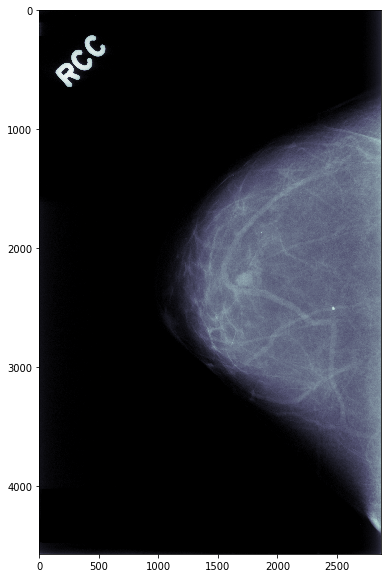

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_MLO_2, 
Patient id..............: Mass-Training_P_00044_RIGHT_MLO_2
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4552 x 2960, 13473920 bytes


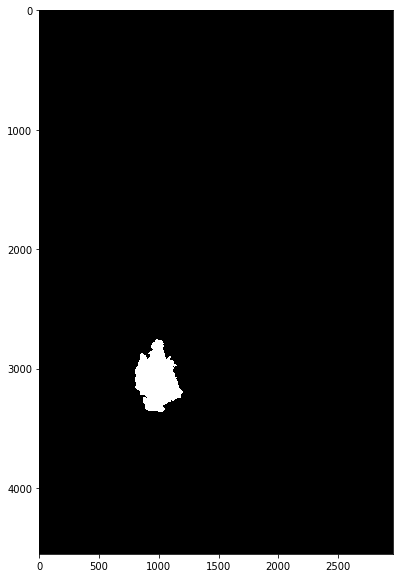

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00004_LEFT_MLO, 
Patient id..............: Mass-Training_P_00004_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 3046, 33451172 bytes


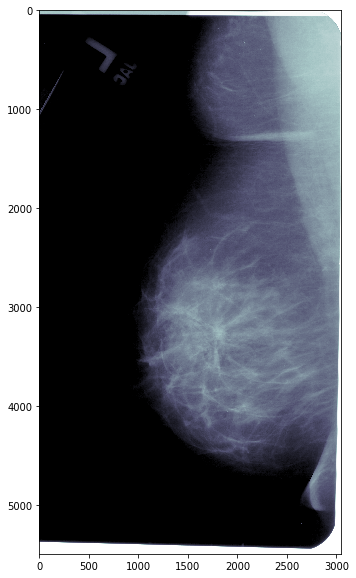

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00046_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00046_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 372 x 443, 329592 bytes


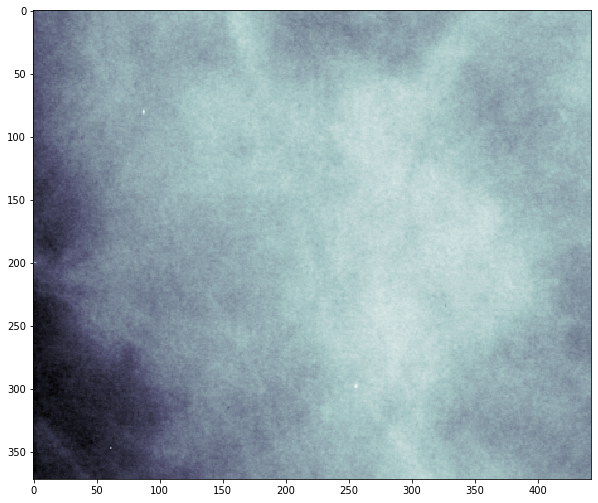

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4504 x 2888, 13007552 bytes


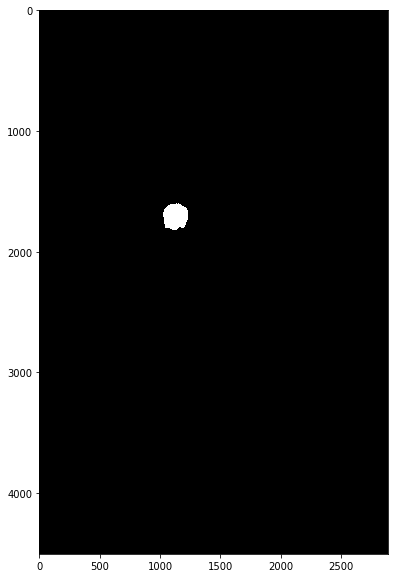

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00041_LEFT_CC, 
Patient id..............: Mass-Training_P_00041_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5664 x 3984, 45130752 bytes


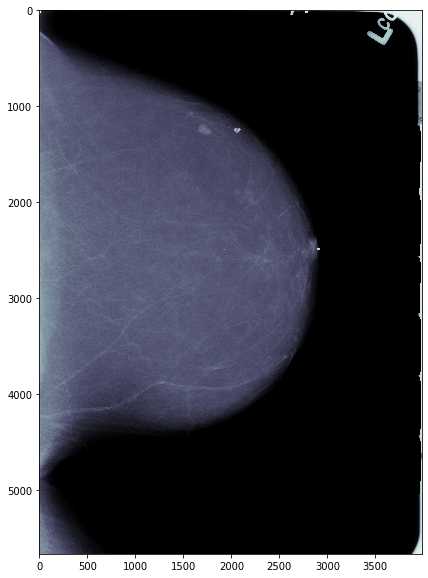

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00004_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00004_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 2911, 15984302 bytes


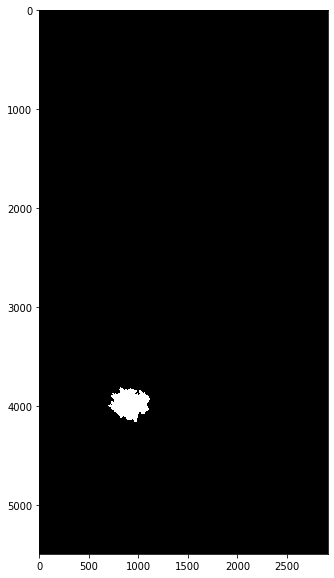

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00004_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00004_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 466 x 423, 394236 bytes


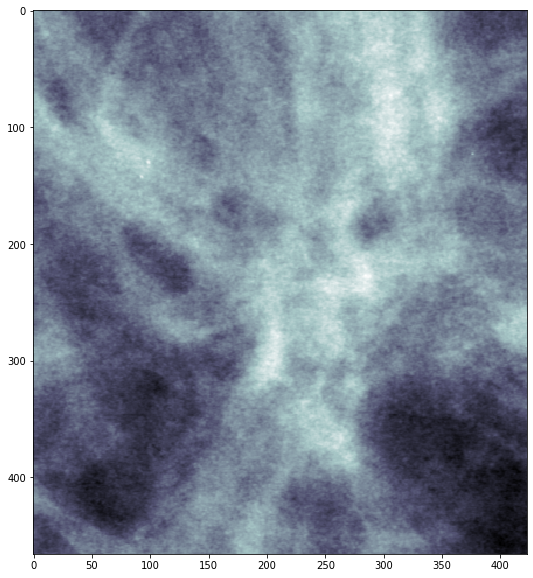

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00034_RIGHT_CC, 
Patient id..............: Mass-Training_P_00034_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 6451 x 3406, 43944212 bytes


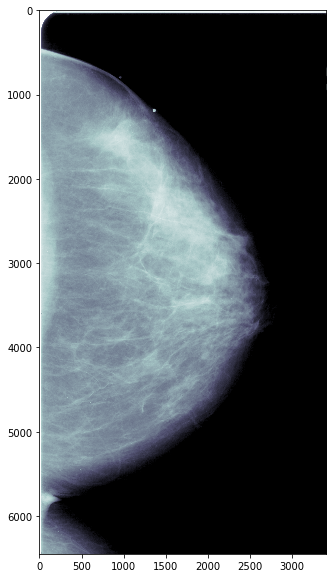

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00027_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00027_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5904 x 3760, 44398080 bytes


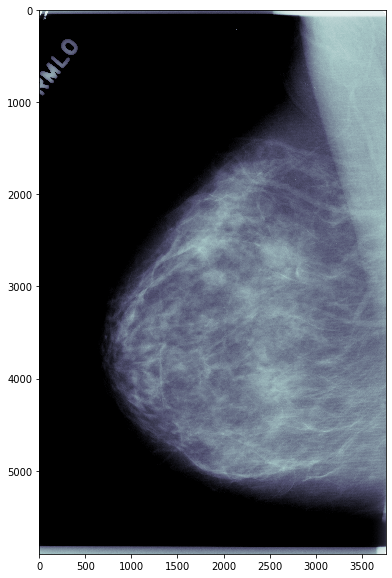

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00018_RIGHT_CC, 
Patient id..............: Mass-Training_P_00018_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4720 x 2584, 24392960 bytes


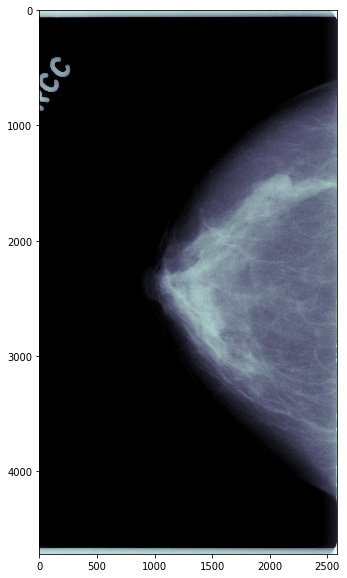

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00001_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00001_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 292 x 256, 149504 bytes


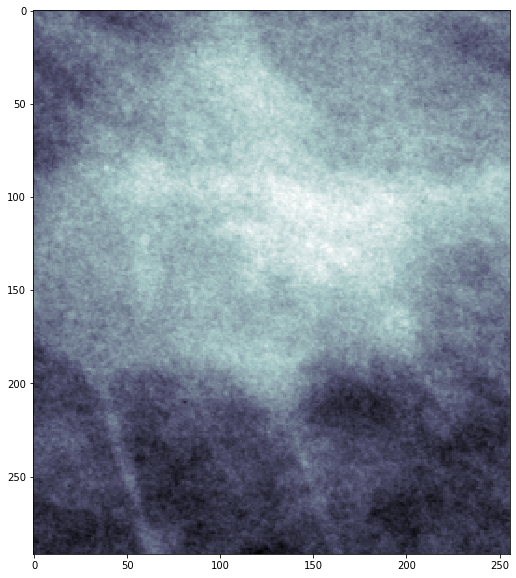

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00001_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00001_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4800 x 2656, 12748800 bytes


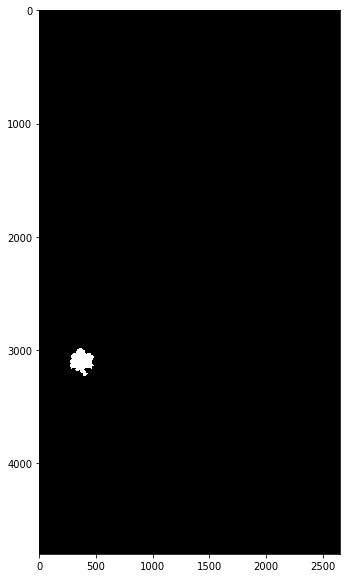

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_4, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_4
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4504 x 2888, 13007552 bytes


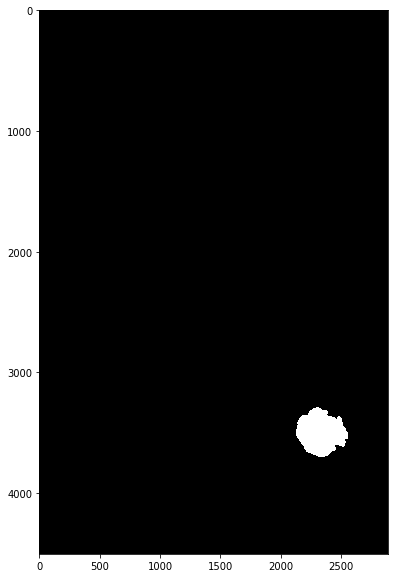

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00046_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00046_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4488 x 2944, 26425344 bytes


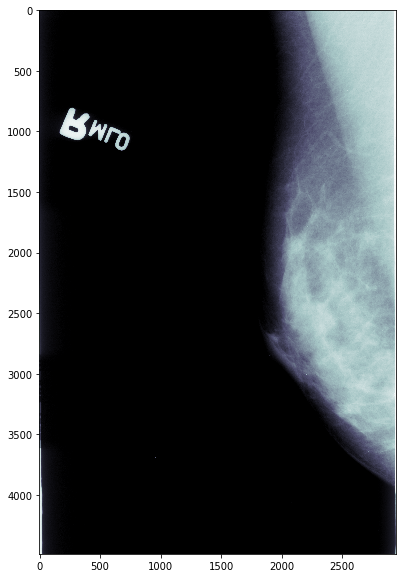

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00009_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00009_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5266 x 2596, 27341072 bytes


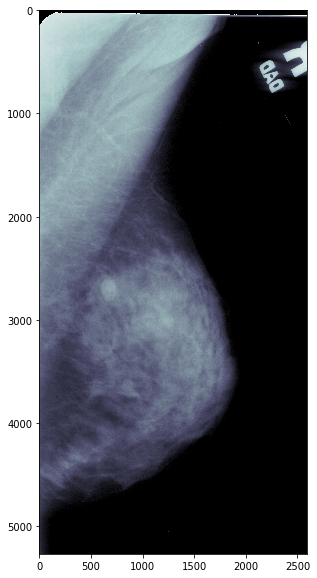

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00039_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00039_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 547 x 464, 507616 bytes


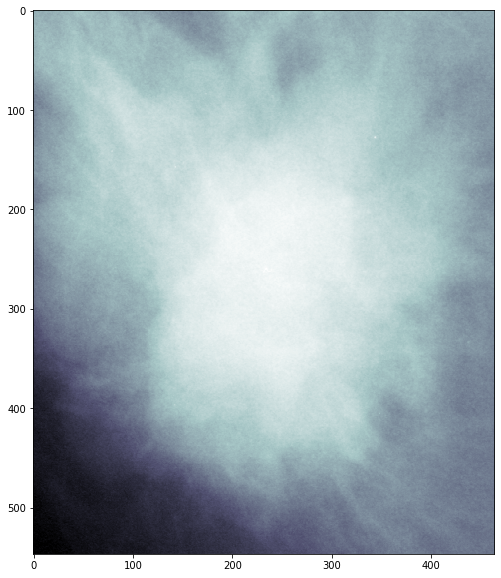

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00001_LEFT_CC, 
Patient id..............: Mass-Training_P_00001_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4808 x 3024, 29078784 bytes


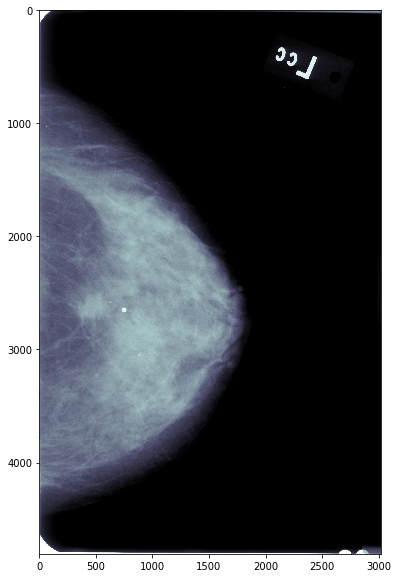

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00023_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00023_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5491 x 3301, 18125792 bytes


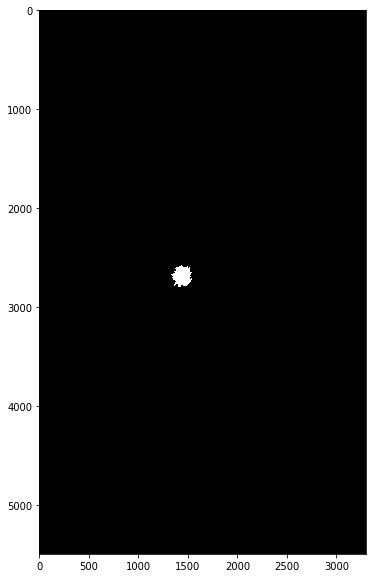

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00039_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00039_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4720 x 2760, 13027200 bytes


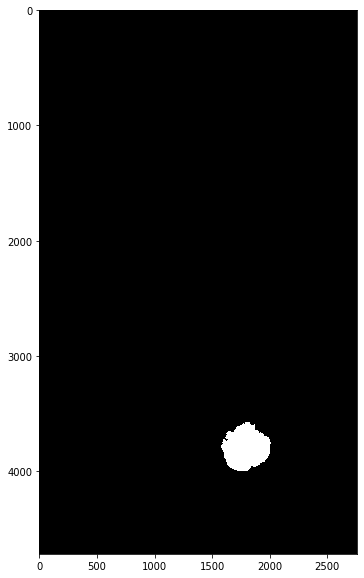

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00057_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00057_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4744 x 2584, 12258496 bytes


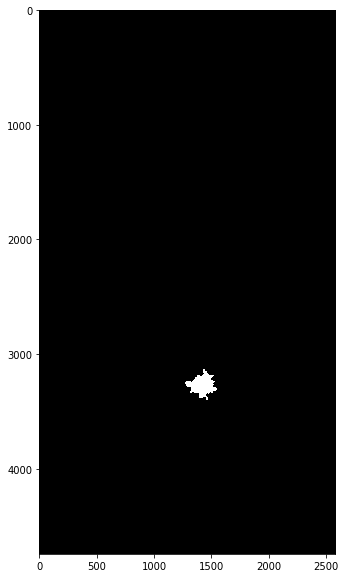

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00034_RIGHT_MLO_1, 
Patient id..............: Mass-Training_P_00034_RIGHT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6871 x 3541, 24330212 bytes


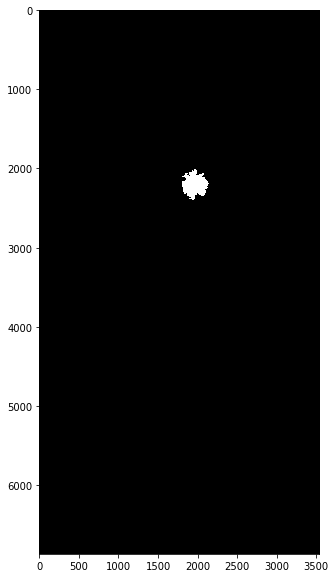

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00055_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00055_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5386 x 3046, 16405756 bytes


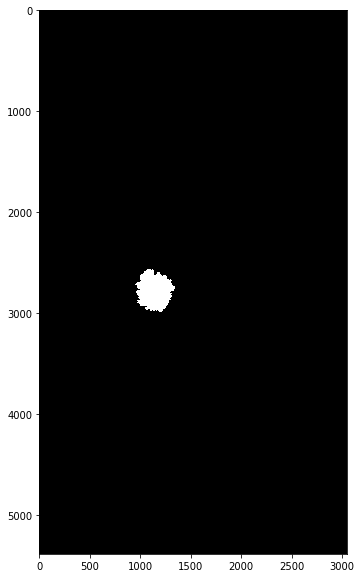

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00021_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00021_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 281 x 298, 167476 bytes


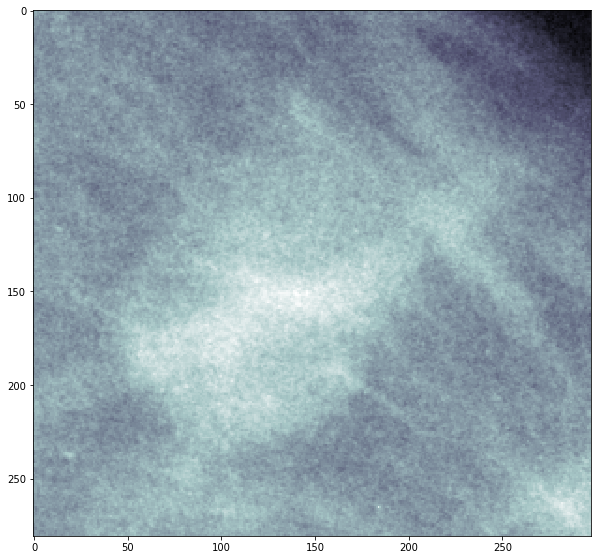

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4504 x 2888, 26015104 bytes


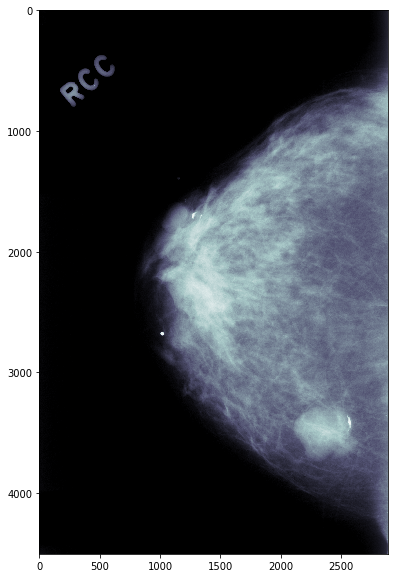

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00021_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00021_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 255 x 277, 141270 bytes


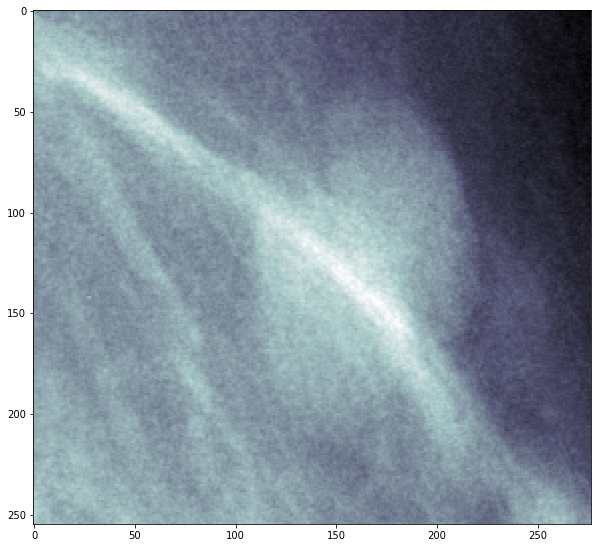

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00041_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00041_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 175 x 219, 76650 bytes


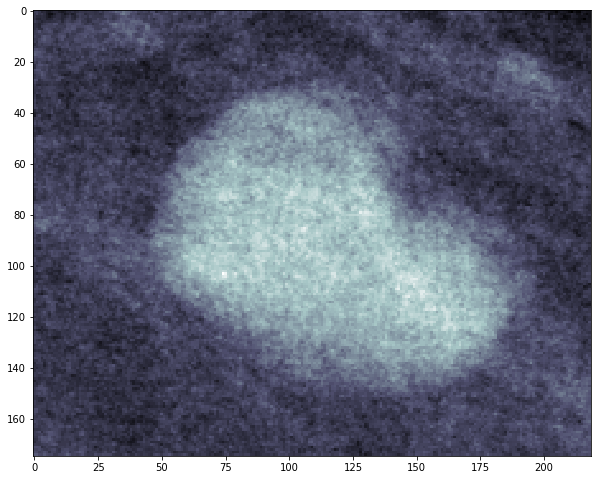

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00026_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00026_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 6706 x 3421, 22941226 bytes


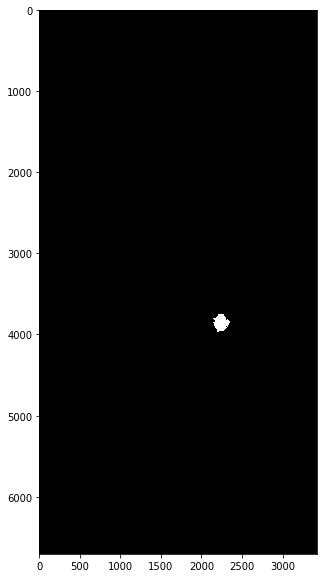

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00041_LEFT_MLO, 
Patient id..............: Mass-Training_P_00041_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5664 x 4040, 45765120 bytes


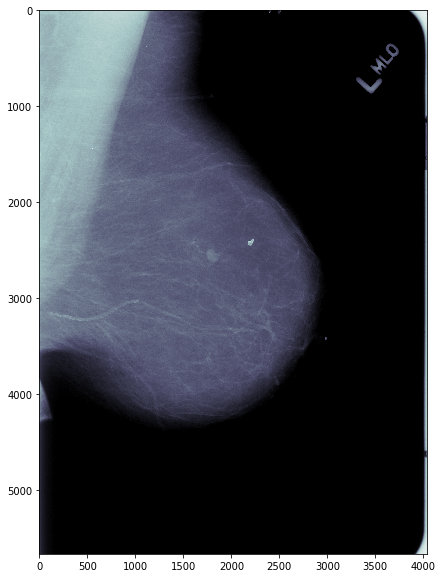

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00045_LEFT_MLO, 
Patient id..............: Mass-Training_P_00045_LEFT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 3316, 36416312 bytes


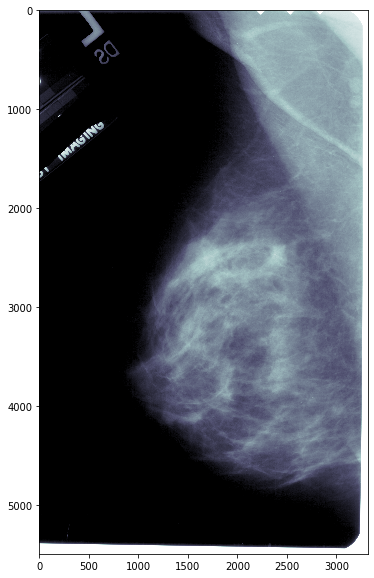

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00045_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00045_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 5491 x 3316, 18208156 bytes


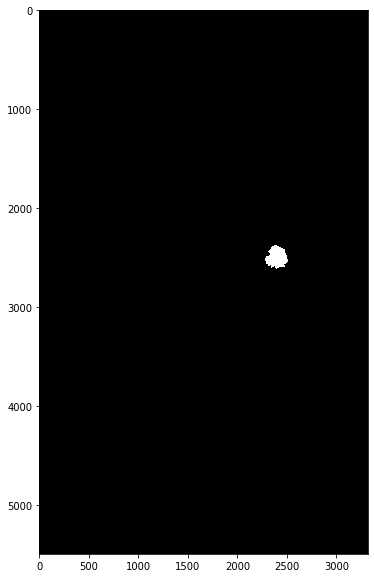

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00009_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00009_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4441 x 2206, 9796846 bytes


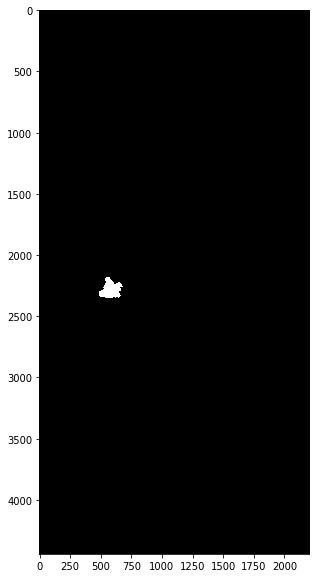

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00044_RIGHT_CC_2, 
Patient id..............: Mass-Training_P_00044_RIGHT_CC_2
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4504 x 2888, 13007552 bytes


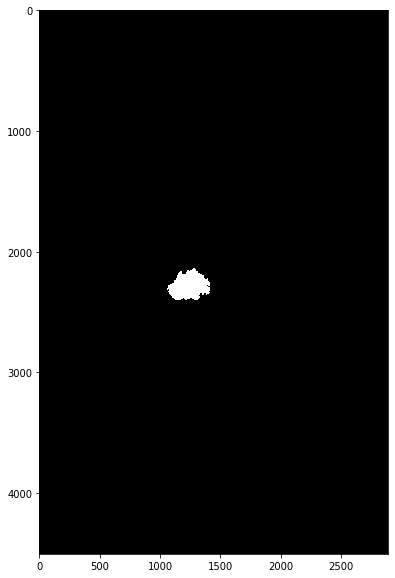

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00051_LEFT_CC, 
Patient id..............: Mass-Training_P_00051_LEFT_CC
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4704 x 2472, 23256576 bytes


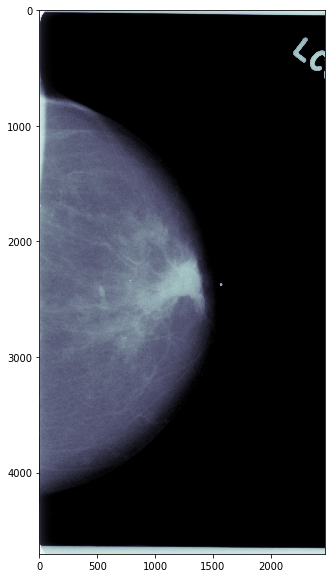

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00021_LEFT_CC_1, 
Patient id..............: Mass-Training_P_00021_LEFT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 4424 x 2928, 12953472 bytes


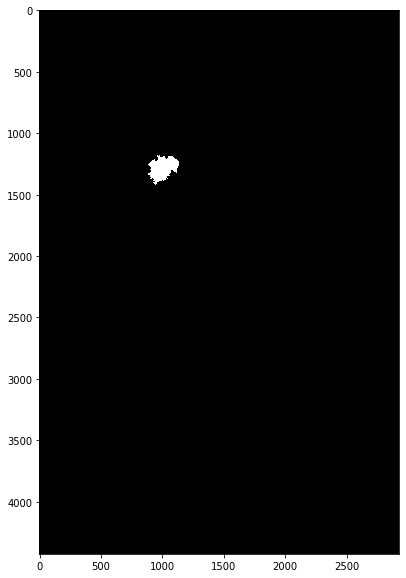

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00057_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00057_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 311 x 319, 198418 bytes


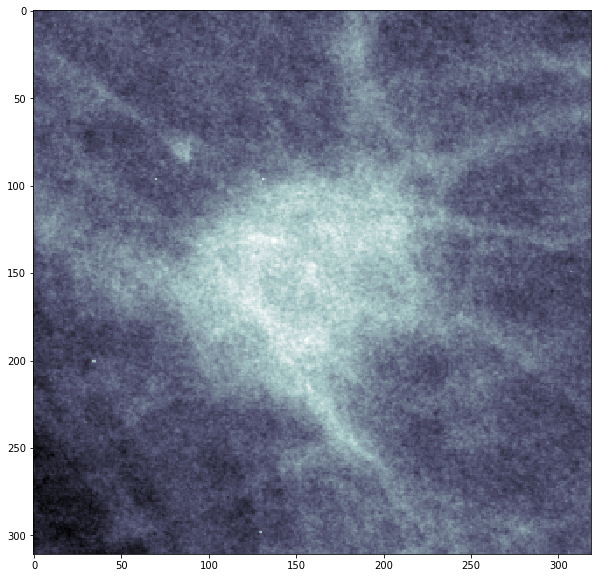

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00027_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00027_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 5896 x 3800, 22404800 bytes


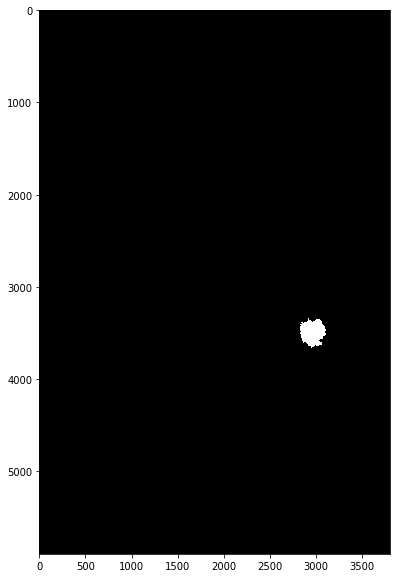

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00023_RIGHT_CC_1, 
Patient id..............: Mass-Training_P_00023_RIGHT_CC_1
Body Part Examined......: BREAST
Patient Orientation.....: CC
Image size.......: 265 x 262, 138860 bytes


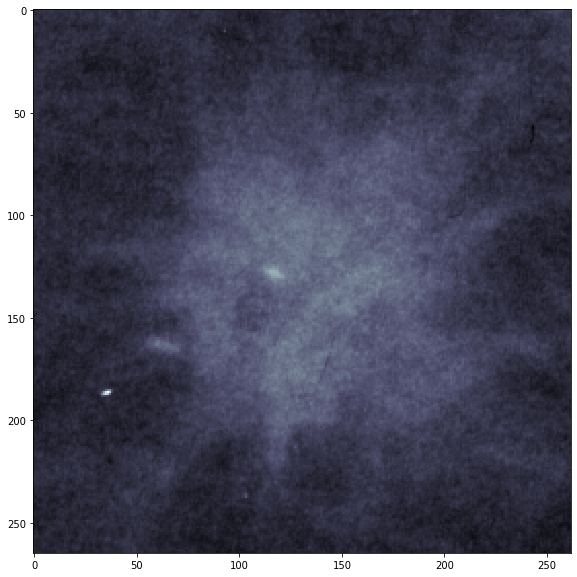

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: ROI mask images
Patient's name..........: Mass-Training_P_00026_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00026_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 6796 x 3361, 22841356 bytes


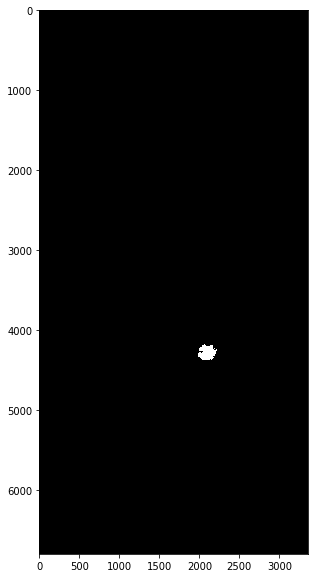

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: cropped images
Patient's name..........: Mass-Training_P_00004_LEFT_MLO_1, 
Patient id..............: Mass-Training_P_00004_LEFT_MLO_1
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 427 x 422, 360388 bytes


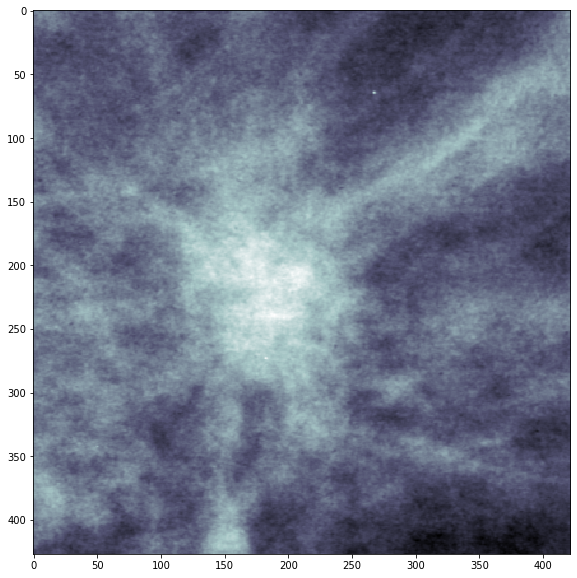

Filename.........: image_cancer/Mass-Training_P_00018_RIGHT_MLO_000000.dcm
Storage type.....: 1.2.840.10008.5.1.4.1.1.7

Series Description .....: full mammogram images
Patient's name..........: Mass-Training_P_00018_RIGHT_MLO, 
Patient id..............: Mass-Training_P_00018_RIGHT_MLO
Body Part Examined......: BREAST
Patient Orientation.....: MLO
Image size.......: 4664 x 2544, 23730432 bytes


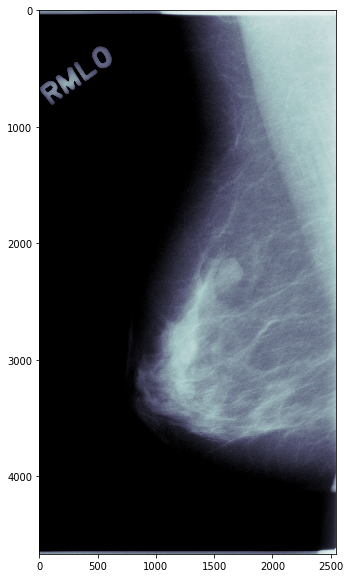

In [10]:
for file_path in glob.glob('image_cancer/*.dcm'):
    dataset = dicom.dcmread(file_path)
    show_dcm_info(dataset)
    plot_pixel_array(dataset)
    #break

In [11]:
source_folder = r'image_cancer'
output_folder=r'image_cancer/png/'


def dicom2png(source_folder, output_folder):
    list_of_files = os.listdir(source_folder)
    for file in list_of_files:
        try:
            ds = dicom.dcmread(os.path.join(source_folder,file))
            shape = ds.pixel_array.shape

            # Convert to float to avoid overflow or underflow losses.
            image_2d = ds.pixel_array.astype(float)

            # Rescaling grey scale between 0-255
            image_2d_scaled = (np.maximum(image_2d,0) / image_2d.max()) * 255.0

            # Convert to uint
            image_2d_scaled = np.uint8(image_2d_scaled)

            # Write the PNG file
            with open(os.path.join(output_folder,file)+'.png' , 'wb') as png_file:
                w = png.Writer(shape[1], shape[0], greyscale=True)
                w.write(png_file, image_2d_scaled)
        except:
            print('Could not convert: ', file)


#dicom2png(source_folder, output_folder)

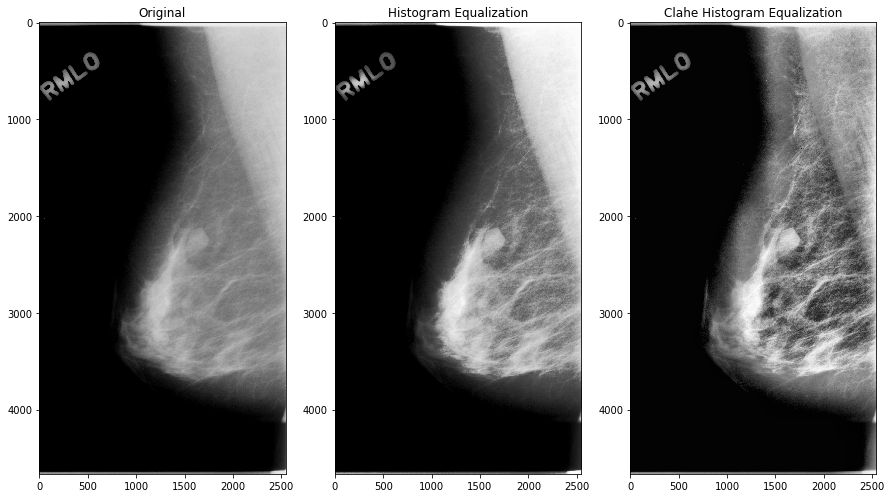

In [12]:
img=cv.imread(image_name+".png",0)
img_hist = cv.equalizeHist(img)
# Plotting
fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15,15))
    
clahe = cv.createCLAHE(clipLimit=4.0, tileGridSize=(8,8))
img_clahe = clahe.apply(img)

ax1.imshow(img, cmap='gray')
ax1.set_title('Original')
#     ax1.imshow(mask, cmap='gray', alpha=0.5)  # Overlay mask

ax2.imshow(img_hist, cmap='gray')
ax2.set_title('Histogram Equalization')
    
ax3.imshow(img_clahe, cmap='gray')
ax3.set_title('Clahe Histogram Equalization')
plt.show()

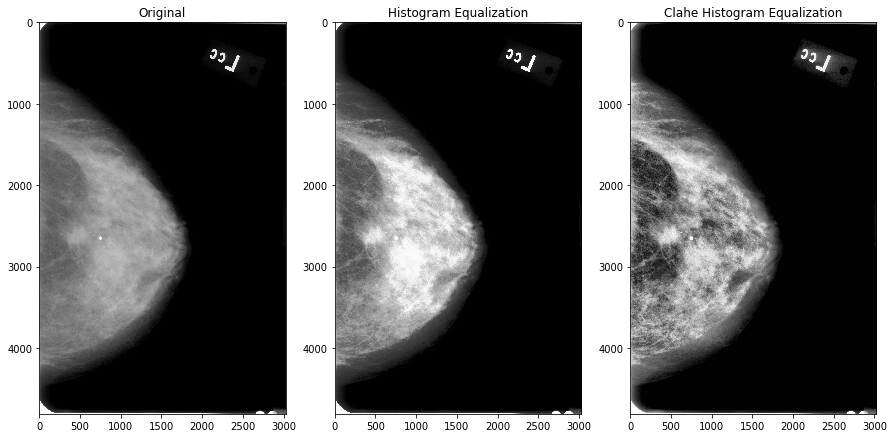

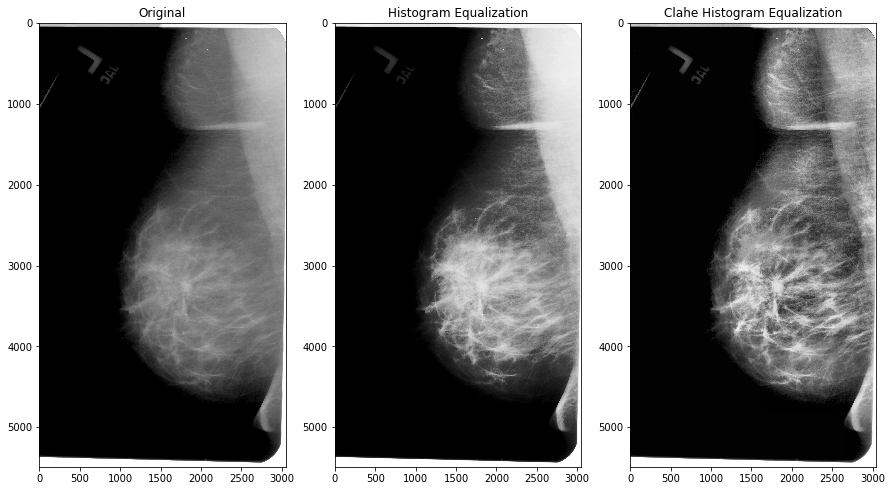

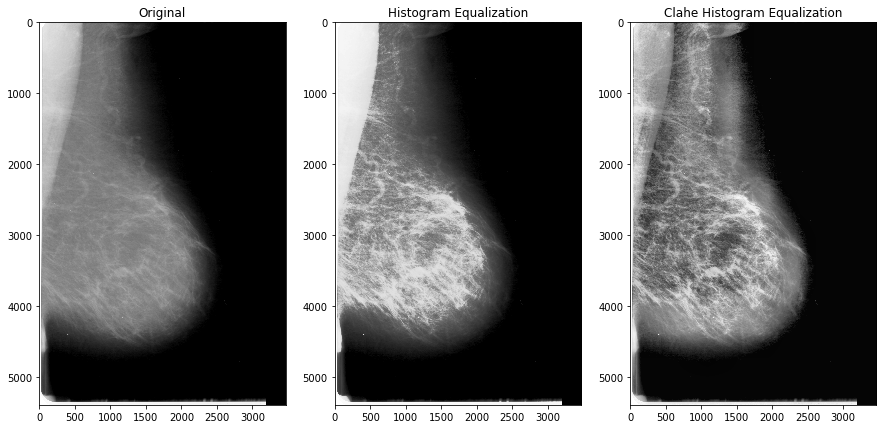

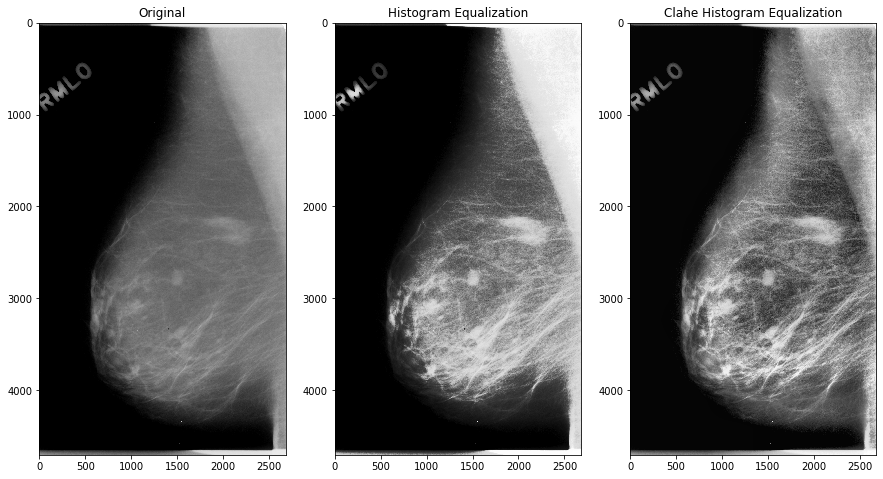

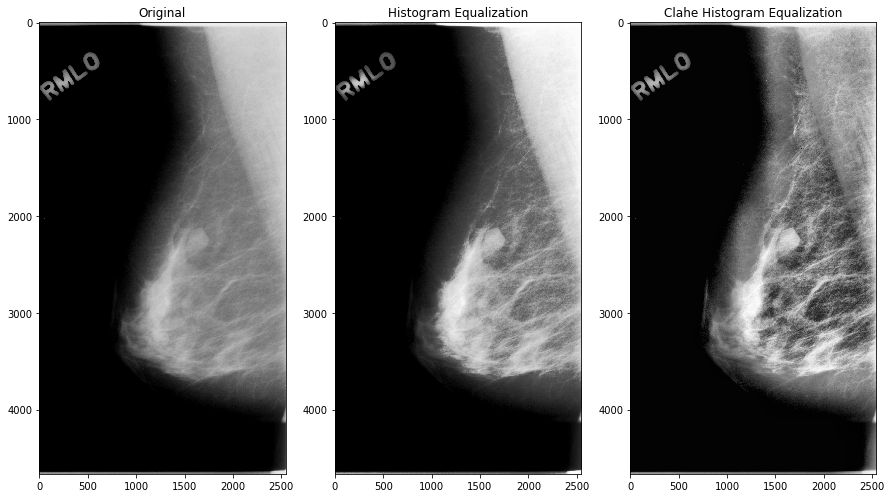

...

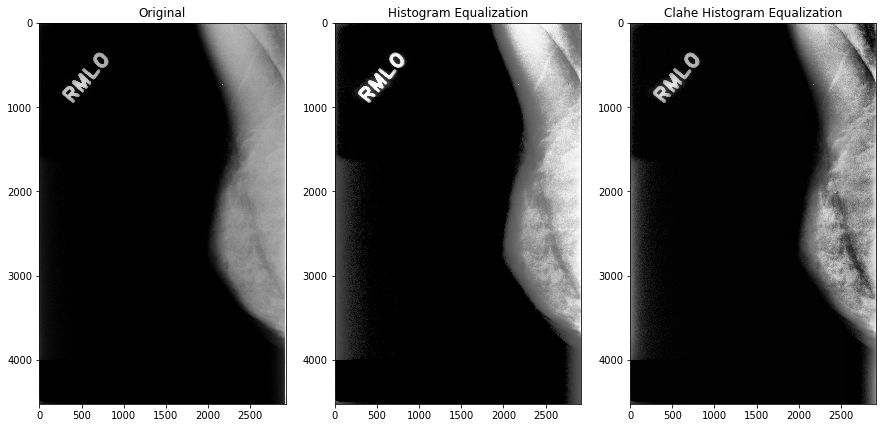

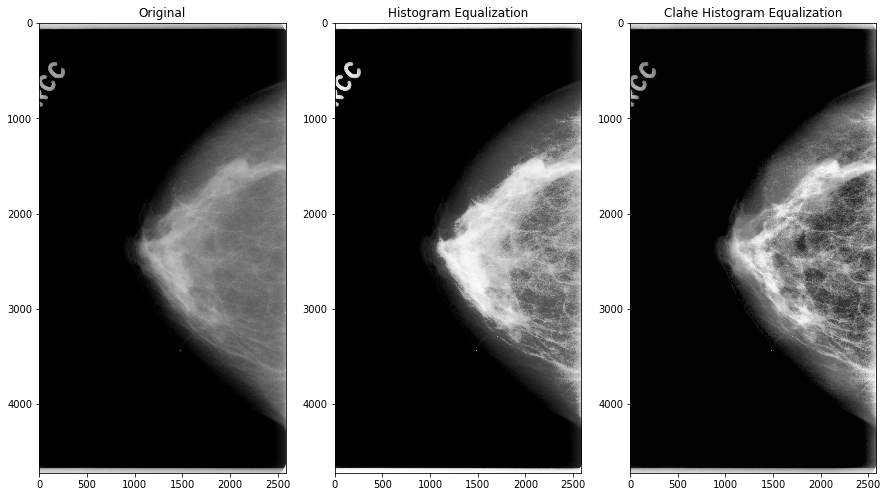

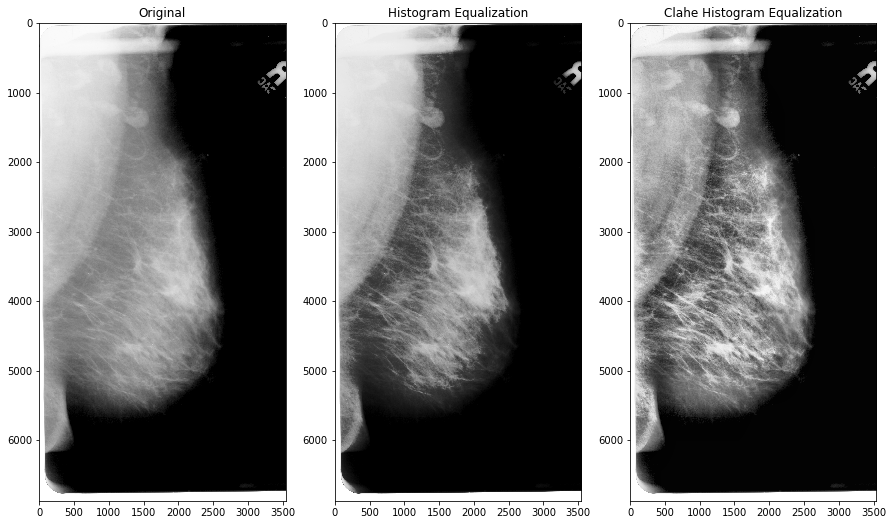

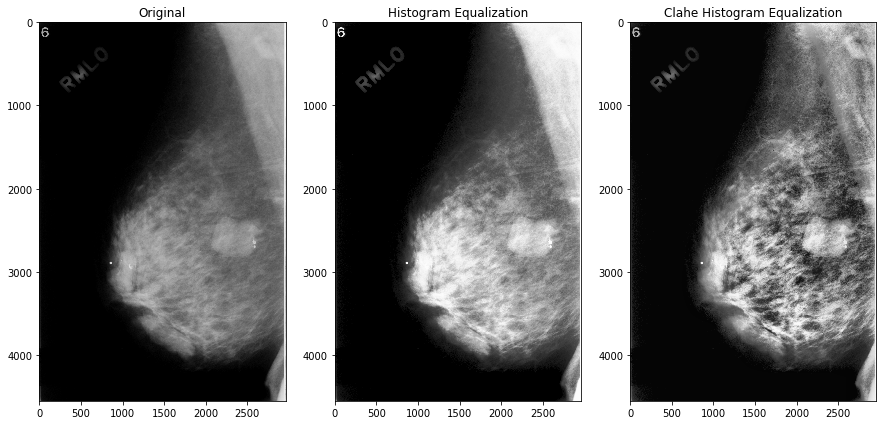

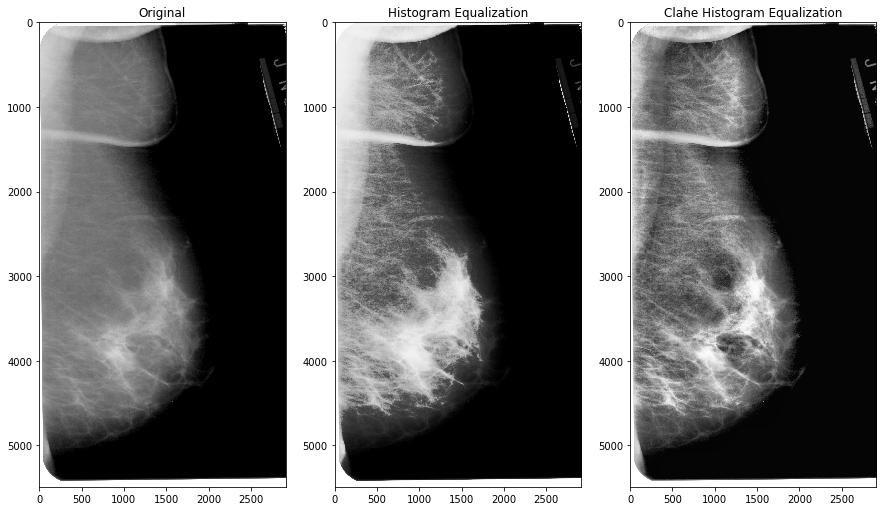

In [13]:
for file_path in glob.glob('image_cancer/png/*.png'):
    
    img=cv.imread(file_path,0)
    img_hist = cv.equalizeHist(img)
    # Plotting
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(15,15))

    clahe = cv.createCLAHE(clipLimit=4.0, tileGridSize=(8,8))
    img_clahe = clahe.apply(img)

    ax1.imshow(img, cmap='gray')
    ax1.set_title('Original')
    #     ax1.imshow(mask, cmap='gray', alpha=0.5)  # Overlay mask

    ax2.imshow(img_hist, cmap='gray')
    ax2.set_title('Histogram Equalization')

    ax3.imshow(img_clahe, cmap='gray')
    ax3.set_title('Clahe Histogram Equalization')
    plt.show()

# Use finding contours for breast segmentation

/home/deep/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


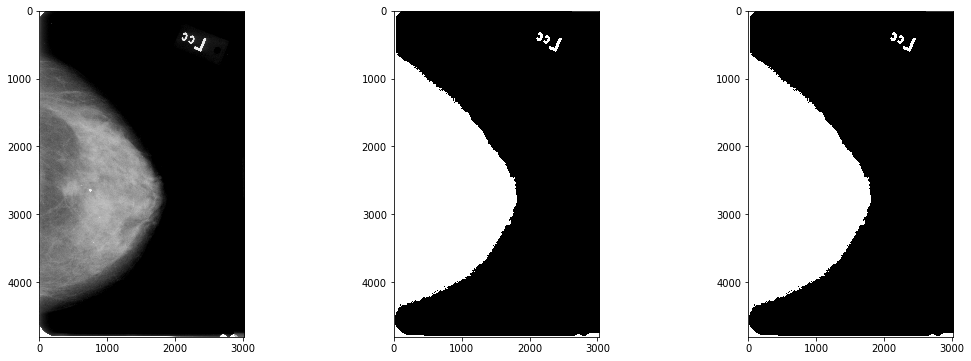

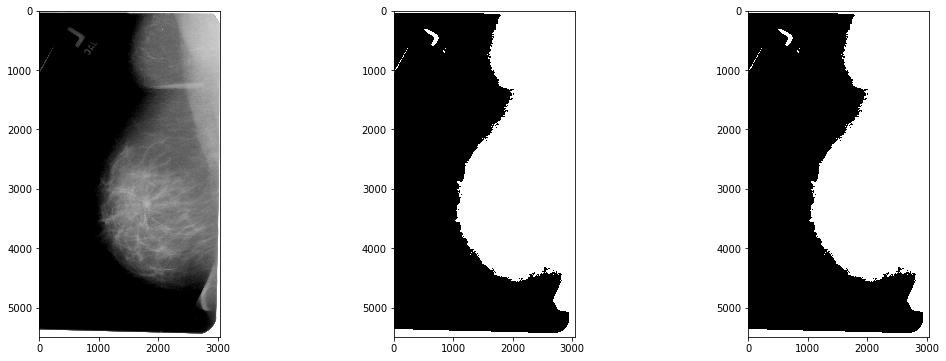

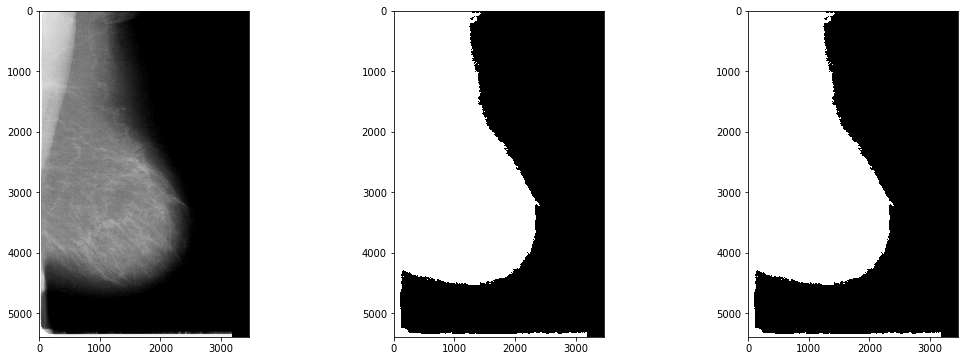

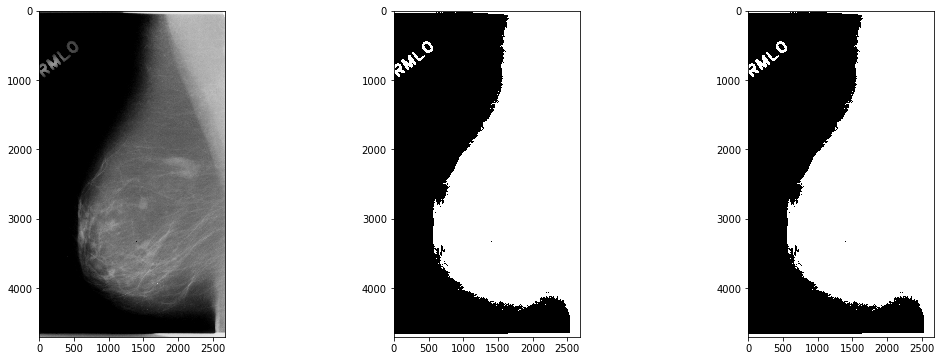

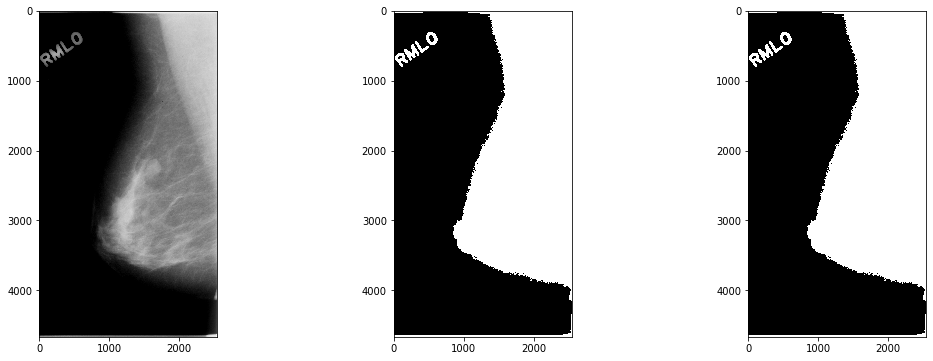

...

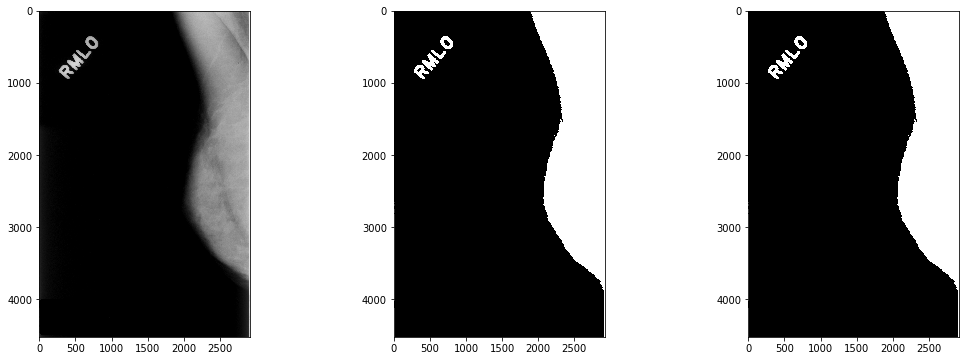

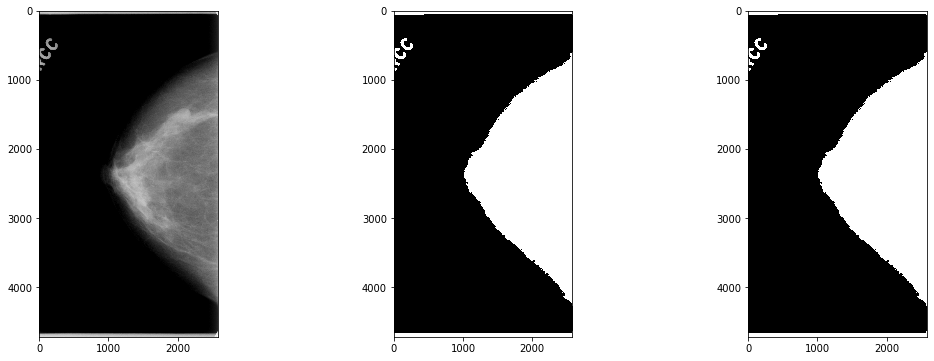

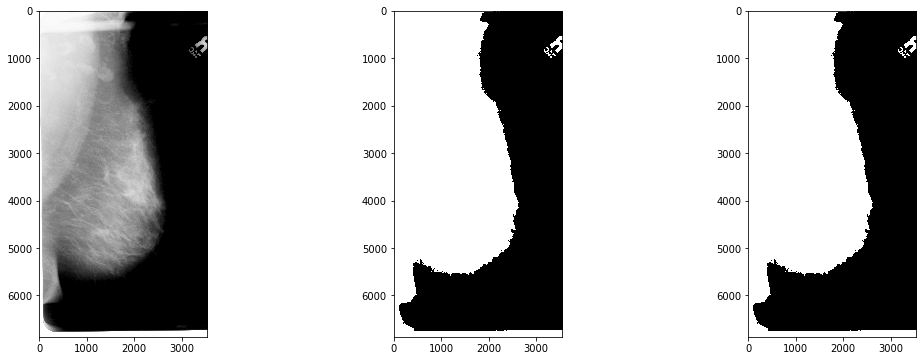

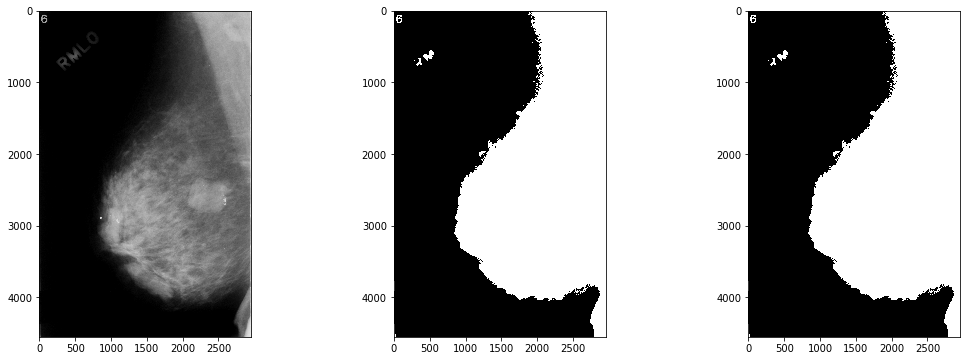

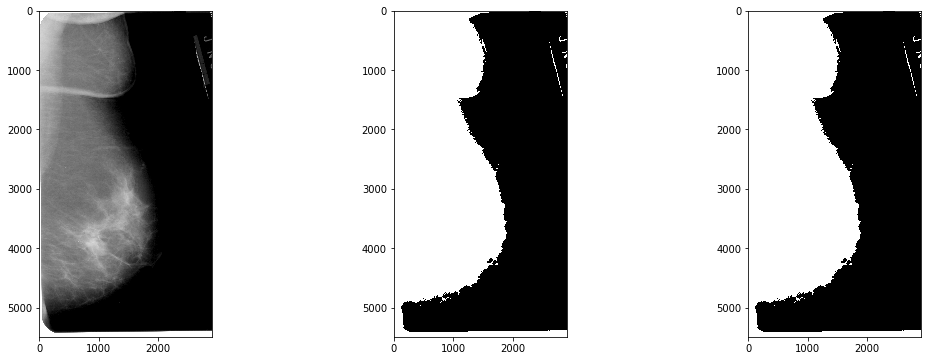

In [14]:
for file_path in glob.glob('image_cancer/png/*.png'):
   # print(file_path)
    img_norm = cv.imread(file_path, cv.IMREAD_UNCHANGED)
    ret,thresh1=cv.threshold(img_norm,50,255,cv.THRESH_BINARY)
    thresh1_,contours,hierarchy = cv.findContours(thresh1.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    fig,axes = subplots(1, 3)
    fig.set_size_inches([18,6])
    axes[0].imshow(img_norm, cmap='gray')
    axes[1].imshow(thresh1, cmap='gray')
    axes[2].imshow(thresh1_, cmap='gray')

# drawing Contours

/home/deep/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


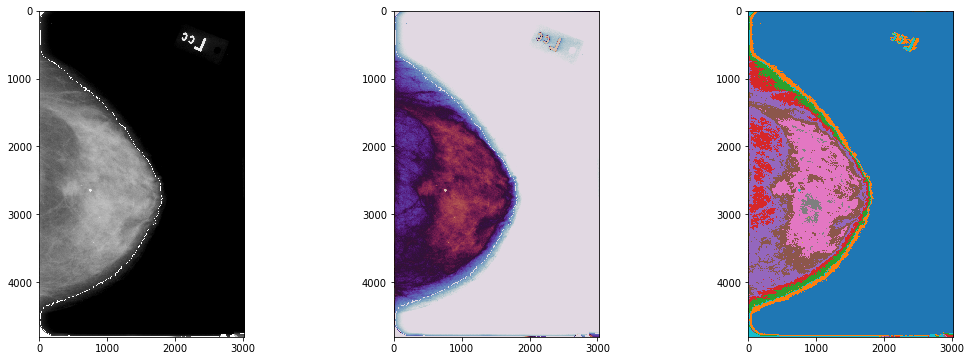

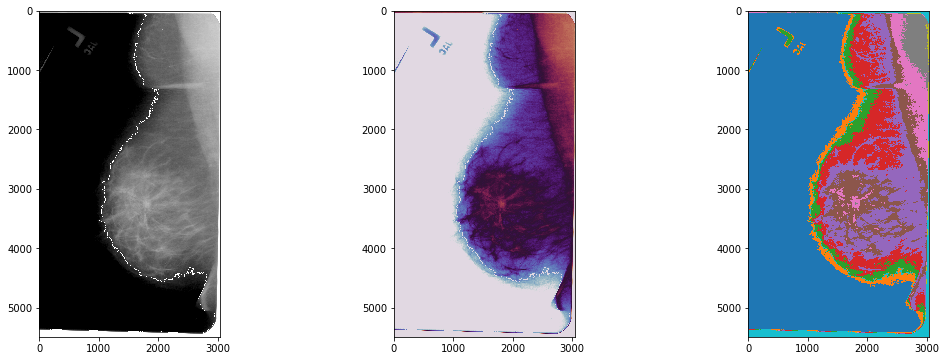

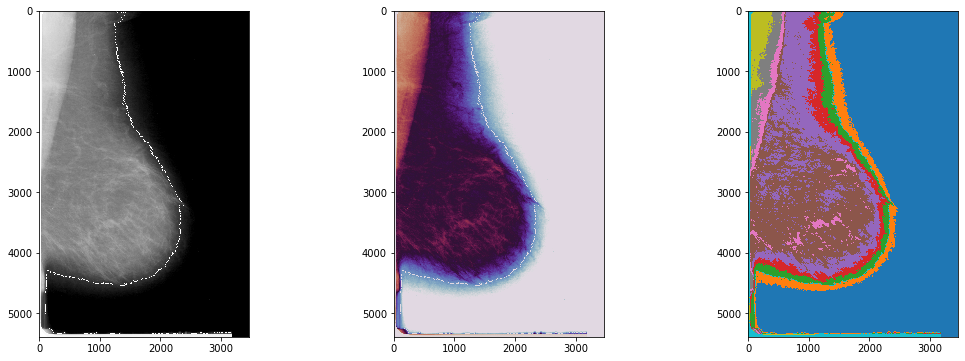

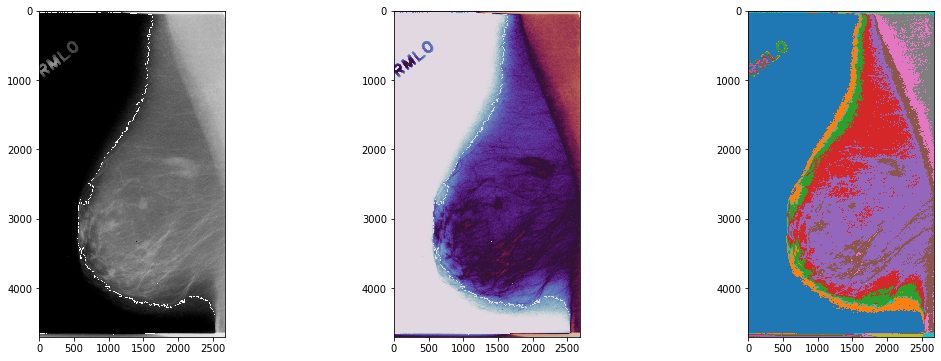

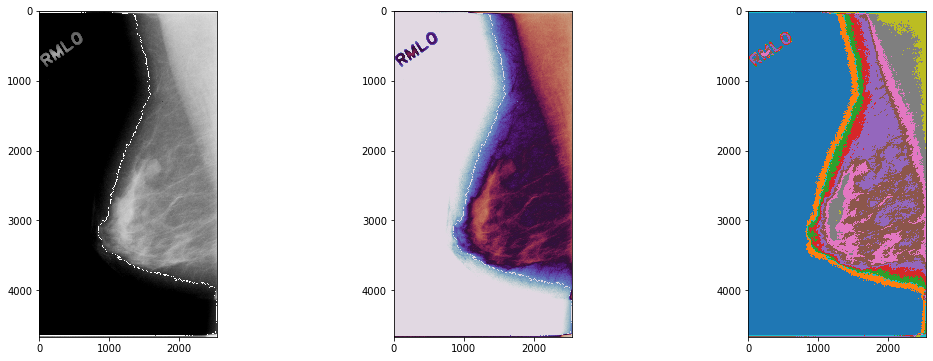

...

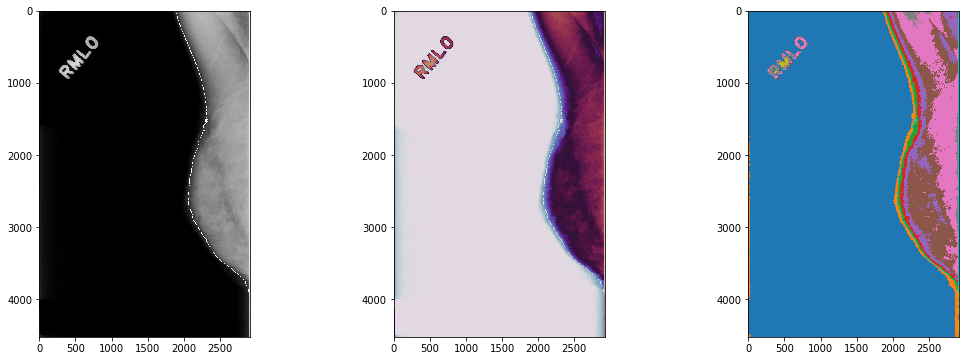

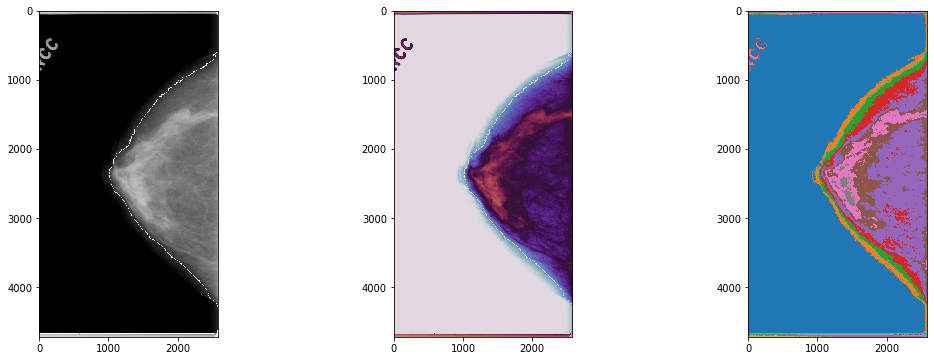

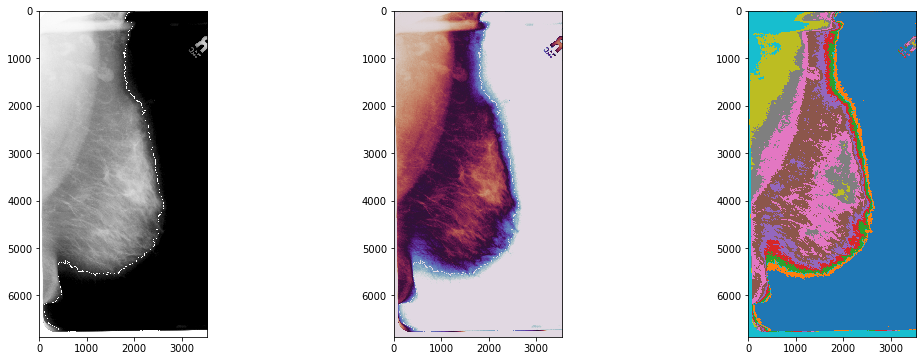

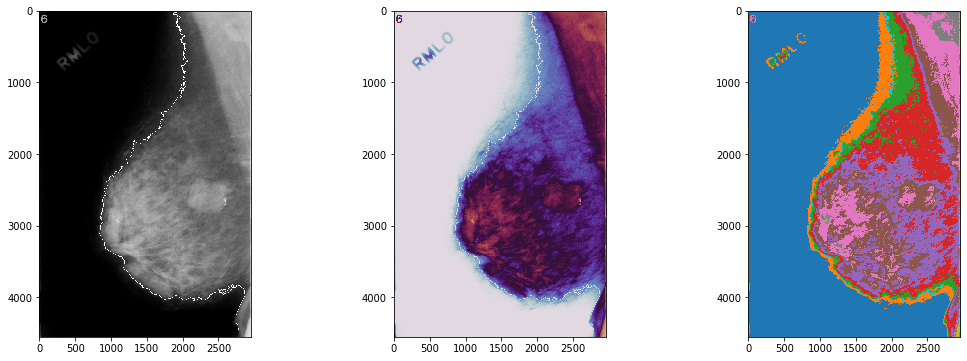

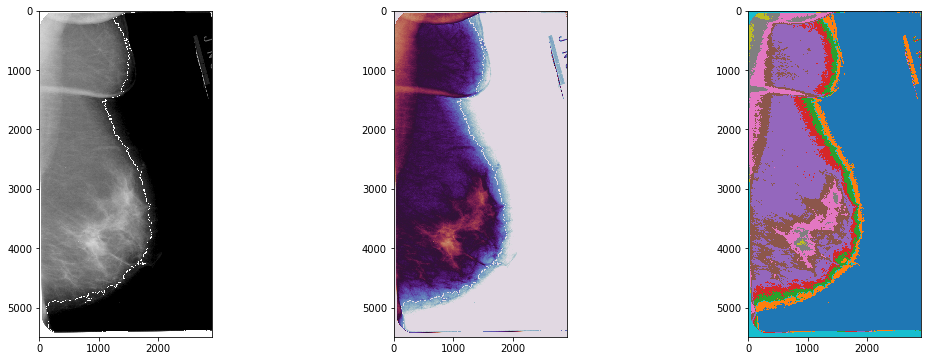

In [15]:
for draw_cont in glob.glob('image_cancer/png/*.png'):
    img_norm = cv.imread(draw_cont, cv.IMREAD_UNCHANGED)
    ret,thresh2=cv.threshold(img_norm,50,255,cv.THRESH_BINARY)
    thresh2_,contours2,hierarchy = cv.findContours(thresh2.copy(), cv.RETR_TREE, cv.CHAIN_APPROX_SIMPLE)
    cont_areas = [cv.contourArea(c_) for c_ in contours2]
    cont = cv.drawContours(img_norm.copy(), contours2, np.argmax(cont_areas), (255,255,255), 3)
    fig,ax = subplots(nrows=1,ncols=3)
    fig.set_size_inches([18, 6])
    ax[0].imshow(cont, cmap='gray')
    ax[1].imshow(cont, cmap='twilight')
    ax[2].imshow(cont, cmap='tab10')
